## Employee Churn Analysis Project
- Data Visualization 
- Data Pre Processing 
- Cluster Analysis 
- Model Building 
- Comparison of Models
- Model deployment 

In [1]:
# 1-Import Libraies

import pandas_profiling
import pyforest

import ipywidgets
from ipywidgets import interact

import numpy as np
import pandas as pd 

import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.ticker as mticker
import squarify as sq

# Importing plotly and cufflinks in offline mode
import plotly.express as px
import cufflinks as cf
import plotly.offline
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

# !pip install termcolor
import colorama
from colorama import Fore, Style  # maakes strings colored
from termcolor import colored
from termcolor import cprint

#from wordcloud import WordCloud

import scipy.stats as stats
from scipy.cluster.hierarchy import linkage, dendrogram
import statsmodels.api as sm
import statsmodels.formula.api as smf
import missingno as msno 

import datetime as dt
from datetime import datetime

#from pyclustertend import hopkins

In [2]:
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.compose import make_column_transformer
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier, GradientBoostingRegressor 
from sklearn.ensemble import ExtraTreesRegressor, AdaBoostClassifier
from sklearn.feature_selection import SelectKBest, SelectPercentile, f_classif, f_regression, mutual_info_regression
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet
from sklearn.metrics import plot_confusion_matrix, r2_score, mean_absolute_error, mean_squared_error, classification_report 
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.metrics import make_scorer, precision_score, precision_recall_curve, plot_precision_recall_curve 
from sklearn.metrics import plot_roc_curve, roc_auc_score, roc_curve, f1_score, accuracy_score, recall_score
from sklearn.metrics import silhouette_samples,silhouette_score
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold, KFold, cross_val_predict, train_test_split
from sklearn.model_selection import StratifiedKFold, GridSearchCV, cross_val_score, cross_validate
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsRegressor, KNeighborsClassifier
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.preprocessing import scale, StandardScaler, MinMaxScaler, RobustScaler
from sklearn.preprocessing import PolynomialFeatures, OneHotEncoder, PowerTransformer, LabelEncoder 
from sklearn.svm import SVR, SVC
from sklearn.tree import plot_tree, DecisionTreeClassifier
from yellowbrick.classifier import ClassificationReport

from xgboost import XGBRegressor, XGBClassifier, plot_importance

In [3]:
# Ignore Warnings
import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")

# Figure&Display options
plt.rcParams["figure.figsize"] = (10,6)
pd.set_option('max_colwidth',200)
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_columns', 200)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# To suppress Pandas Future warning
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [4]:
## Some Useful Functions


def missing_values(df):
    missing_number = df.isnull().sum().sort_values(ascending = False)
    missing_percent = (df.isnull().sum() / df.isnull().count()).sort_values(ascending = False)
    missing_values = pd.concat([missing_number, missing_percent], axis = 1, keys = ['Missing_Number', 'Missing_Percent'])
    return missing_values[missing_values['Missing_Number'] > 0]


def first_looking(df):
    print(colored("Shape:", attrs=['bold']), df.shape,'\n', 
          colored('*'*100, 'red', attrs = ['bold']),
          colored("\nInfo:\n", attrs = ['bold']), sep = '')
    print(df.info(), '\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    print(colored("Number of Uniques:\n", attrs = ['bold']), df.nunique(),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    print(colored("Missing Values:\n", attrs=['bold']), missing_values(df),'\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    print(colored("All Columns:", attrs = ['bold']), list(df.columns),'\n', 
          colored('*'*100, 'red', attrs = ['bold']), sep = '')

    df.columns = df.columns.str.lower().str.replace('&', '_').str.replace(' ', '_')
    print(colored("Columns after rename:", attrs = ['bold']), list(df.columns),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '')  
    print(colored("Columns after rename:", attrs = ['bold']), list(df.columns),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '')
    print(colored("Descriptive Statistics \n", attrs = ['bold']), df.describe().round(2),'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '') # Gives a statstical breakdown of the data.
    print(colored("Descriptive Statistics (Categorical Columns) \n", attrs = ['bold']), df.describe(include = object).T,'\n',
          colored('*'*100, 'red', attrs = ['bold']), sep = '') # Gives a statstical breakdown of the data.
    
def multicolinearity_control(df):
    feature = []
    collinear = []
    for col in df.corr().columns:
        for i in df.corr().index:
            if (abs(df.corr()[col][i]) > .9 and abs(df.corr()[col][i]) < 1):
                    feature.append(col)
                    collinear.append(i)
                    print(colored(f"Multicolinearity alert in between:{col} - {i}", 
                                  "red", attrs = ['bold']), df.shape,'\n',
                                  colored('*'*100, 'red', attrs = ['bold']), sep = '')

def duplicate_values(df):
    print(colored("Duplicate check...", attrs = ['bold']), sep = '')
    print("There are", df.duplicated(subset = None, keep = 'first').sum(), "duplicated observations in the dataset.")
    duplicate_values = df.duplicated(subset = None, keep = 'first').sum()
    if duplicate_values > 0:
        df.drop_duplicates(keep = 'first', inplace = True)
        print(duplicate_values, colored(" Duplicates were dropped!"),'\n',
              colored('*'*100, 'red', attrs = ['bold']), sep = '')
#     else:
#         print(colored("There are no duplicates"),'\n',
#               colored('*'*100, 'red', attrs = ['bold']), sep = '')     
        
# def drop_columns(df, drop_columns):
#     if drop_columns != []:
#         df.drop(drop_columns, axis = 1, inplace = True)
#         print(drop_columns, 'were dropped')
#     else:
#         print(colored('We will now check the missing values and if necessary, the related columns will be dropped!', attrs = ['bold']),'\n',
#               colored('*'*100, 'red', attrs = ['bold']), sep = '')
        
def drop_null(df, limit):
    print('Shape:', df.shape)
    for i in df.isnull().sum().index:
        if (df.isnull().sum()[i] / df.shape[0]*100) > limit:
            print(df.isnull().sum()[i], 'percent of', i ,'null and were dropped')
            df.drop(i, axis = 1, inplace = True)
            print('new shape:', df.shape)       
    print('New shape after missing value control:', df.shape)
    

# To view summary information about the columns

def first_look(col):
    print("column name    : ", col)
    print("--------------------------------")
    print("Per_of_Nulls   : ", "%", round(df[col].isnull().sum() / df.shape[0]*100, 2))
    print("Num_of_Nulls   : ", df[col].isnull().sum())
    print("Num_of_Uniques : ", df[col].nunique())
    print("Duplicates     : ", df.duplicated(subset = None, keep = 'first').sum())
    print(df[col].value_counts(dropna = False))
    

def fill_most(df, group_col, col_name):
    '''Fills the missing values with the most existing value (mode) in the relevant column according to single-stage grouping'''
    for group in list(df[group_col].unique()):
        cond = df[group_col] == group
        mode = list(df[cond][col_name].mode())
        if mode != []:
            df.loc[cond, col_name] = df.loc[cond, col_name].fillna(df[cond][col_name].mode()[0])
        else:
            df.loc[cond, col_name] = df.loc[cond, col_name].fillna(df[col_name].mode()[0])
    print("Number of NaN : ",df[col_name].isnull().sum())
    print("------------------")
    print(df[col_name].value_counts(dropna = False))
    
# show values in bar graphic

def show_values_on_bars(axs):
    def _show_on_single_plot(ax):        
        for p in ax.patches:
            _x = p.get_x() + p.get_width() / 2
            _y = p.get_y() + p.get_height()
            value = '{:.2f}'.format(p.get_height())
            ax.text(_x, _y, value, ha="center") 
    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _show_on_single_plot(ax)
    else:
        _show_on_single_plot(axs)

## Data Cleaning and EDA
Pandas profiling is an open source Python module with which we can quickly do an exploratory data analysis with just a few lines of code. Similarly, for EDA, profile_report() is One-Line Magical Code creating reports in the interactive HTML format which is quite easy to understand and analyze the data. In short, at the first hand, what pandas profiling does is to save us all the work of visualizing and understanding the distribution of each variable.

For a better understanding and more information, please refer to Source 1 & Source 2

In [5]:
# df.profile_report()

In [6]:
# first_looking(df)
# duplicate_values(df)
# print(colored("Shape:", attrs = ['bold']), df.shape,'\n', colored('*'*100, 'red', attrs = ['bold']))

According to the basic examinations on the dataset;

- There has been a classification problem.
- We are going to make classification on the target variable "left".
- So a model will be built to get the best classification on the "left" column.
- Moreover, being balanced of "left" column or not will be take into consideration meticolously.
- The dataset has 10 columns and 11991 observations after dropping of duplicated observations.
- 8 columns contain numerical values and 2 columns contain categorical values.
- There seems to be no missing value.

In [7]:
# df.columns

In [8]:
# df.rename({'departments_': 'department'}, axis=1, inplace=True)
# df.head()

In [9]:
# # Alternative code
# # last_column = df.pop('left')
# # df.insert(9, 'left', last_column)
# # df.head(1)

# df = df[['satisfaction_level', 'last_evaluation', 'number_project',
#        'average_montly_hours', 'time_spend_company', 'work_accident',
#        'promotion_last_5years', 'department', 'salary', 'left']]
# df.head()

## 4.2 - The Examination of Features


In the given dataset, we have two types of employee one who stayed and another who left the company. So, we can divide data into two groups and compare their characteristics. Here, we can find the average of both the groups using groupby() and mean() function.

- Before jumping into modelling, let's try to get some information by examining the columns in the dataset one by one.

'left' Column-Target Column

In [10]:
# cprint("Have a First Look to 'left' Column",'green')
# first_look('left')

In [11]:
# df['left'].value_counts().iplot(kind="bar", title = '"left" Column Distribution')

In [12]:
# fig = px.pie(df, values = df['left'].value_counts(), 
#              names = (df['left'].value_counts()).index, 
#              title = '"left" Column Distribution')
# fig.show()

In [13]:
# y = df['left']
# print(f'Percentage of left-1: % {round(y.value_counts(normalize=True)[1]*100,2)} --> \
# ({y.value_counts()[1]} observations for left-1)\nPercentage of left-0: % {round(y.value_counts(normalize=True)[0]*100,2)} --> ({y.value_counts()[0]} observations for left-0)')

- The target column, 'left', has binary type values.
- There has been an imbalanced data for the analysis.
- Almost 17% of the employees prefered NOT to continue with the company and left.
- 1991 employees left.
- Almost 83% of the employees prefered to continue with the company and stayed.
- 10000 employees stayed.

In [14]:
# df.groupby('left').mean()

In [15]:
# cprint('Dataset describe results according to the "left==1" condition','green')
# df[df['left'] == 1].describe().T.style.background_gradient(subset = ['mean','min','50%', 'max'], cmap = 'RdPu')

In [16]:
# cprint('Dataset describe results according to the "left==0" condition','green')
# df[df['left'] == 0].describe().T.style.background_gradient(subset = ['mean','min','50%', 'max'], cmap = 'RdPu')

'satisfaction_level' Column

In [17]:
# cprint("Have a First Look to 'left' Column",'green')
# first_look('satisfaction_level')

In [18]:
# df['satisfaction_level'].value_counts().iplot(kind="bar", title = '"satisfaction_level" Column Distribution')

In [19]:
# px.histogram(df, x = df['satisfaction_level'], color='left', marginal = "box", hover_data = df.columns, 
#              title = 'satisfaction_level and left')

In [20]:
# pd.crosstab(df['satisfaction_level'], df['left']).iplot(kind='bar', title = 'satisfaction_level and left')

In [21]:
# sns.scatterplot(data=df, x="satisfaction_level", y="left", hue="left");

In [22]:
# df.corr(method='pearson')[7:]

- Although it is expected that there should be a linear relationship between 'satisfaction_level' and 'left', it does not seem clearly on the graph due to the type of "left" feature.
- Those with a 'satisfaction_level' value of around 0.1 are more likely to be 'left'.
- There is a significant increase in the number of those labeled 'left' whose 'satisfaction_level' value is between 0.55. In fact, the number of those who left their companies exceeds that of the ones who not.
- When the 'satisfaction_level' value is around between 0.7 and 0.9, there is an increase in the number of those who left.
- Except for these intervals, no matter how low the satisfaction_level was, the employees continued their work.

### 'last_evaluation' Column

In [23]:
# cprint("Have a First Look to 'last_evaluation' Column",'green')
# first_look('last_evaluation')

In [24]:
# df['last_evaluation'].value_counts().iplot(kind="bar", title = '"last_evaluation" Column Distribution')

In [25]:
# px.histogram(df, x = df['last_evaluation'], color='left', marginal = "box", hover_data = df.columns, 
#              title = 'last_evaluation and left')

In [26]:
# pd.crosstab(df['last_evaluation'], df['left']).iplot(kind='bar', title = 'last_evaluation and left')

- There is a local increase between 0.45-0.6 and 0.8-1 in the 'last_evaluation' values, as in 'satisfaction_level' values. There is an increase in the number of people who quit their jobs in these intervals.

### 'number_project' Column

In [27]:
# cprint("Have a First Look to 'number_project' Column",'green')
# first_look('number_project')

In [28]:
# df['number_project'].value_counts().iplot(kind="bar", title = '"number_project" Column Distribution')

In [29]:
# fig = px.pie(df, values = df['number_project'].value_counts(), 
#              names = (df['number_project'].value_counts()).index, 
#              title = '"number_project" Column Distribution')
# fig.show()

In [30]:
# px.histogram(df, x = df['number_project'], color='left', marginal = "box", hover_data = df.columns, 
#              title = 'number_project and left')

In [31]:
# pd.crosstab(df['number_project'], df['left']).iplot(kind='bar', title = 'number_project and left')

It's clear that the employees who made 2, 6 and 7 projects are more inclined to leave their works. It's normal to expect employees who made more projects but not getting more salary or feeling more satisfaction to leave their works;however, those who left even though making less projects should be scrutinized more meticulously.

### 'average_montly_hours' Column

In [32]:
# cprint("Have a First Look to 'average_montly_hours' Column",'green')
# first_look('average_montly_hours')

In [33]:
# df['average_montly_hours'].value_counts().iplot(kind="bar", title = "average_montly_hours" Column Distribution')

In [34]:
# px.histogram(df, x = df['average_montly_hours'], color='left', marginal = "box", hover_data = df.columns, 
#              title = 'average_montly_hours and left')

In [35]:
# pd.crosstab(df['average_montly_hours'], df['left']).iplot(kind='bar', title = 'average_montly_hours and left')

- Looking at the 'average_montly_hours' values, there is a local increase in turnover in the 125-160 month working hours range and 210-290 monthly working hours.
- Those who work more than 290 hours per month are more likely to quit their jobs than those who do not.

How does workload affect employee churn?

In [36]:
# plt.figure(figsize=(15, 8))
# fig = sns.histplot(
#     df,
#     x="average_montly_hours", hue="left",
#     multiple="stack",
#     palette="light:m_r",
#     edgecolor=".3",
#     linewidth=.5
# )
# fig2 = fig.twinx()

# fig.yaxis.set_label_position('left')
# fig2.yaxis.set_label_position('right')

# fig2.set_ylabel('frequency [%]')

# for p in fig.patches:
#     x=p.get_bbox().get_points()[:,0]
#     y=p.get_bbox().get_points()[1,1]
#     fig.annotate('{:.1f}%'.format(100.*y/len(df)), (x.mean(), y), 
#             ha='center', va='bottom') # set the alignment of the text
# fig2.grid(None)
# fig2.set_ylim(0,100)

In [37]:
df = pd.read_csv('data.csv')
df.head()

,Unnamed: 0,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department,salary,left
0,0,0.380,0.530,2,157,3,0,0,sales,low,1
1,1,0.800,0.860,5,262,6,0,0,sales,medium,1
2,2,0.110,0.880,7,272,4,0,0,sales,medium,1
3,3,0.720,0.870,5,223,5,0,0,sales,low,1
4,4,0.370,0.520,2,159,3,0,0,sales,low,1


In [38]:
df = df.drop(['Unnamed: 0'], axis = 1)
df.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department,salary,left
0,0.380,0.530,2,157,3,0,0,sales,low,1
1,0.800,0.860,5,262,6,0,0,sales,medium,1
2,0.110,0.880,7,272,4,0,0,sales,medium,1
3,0.720,0.870,5,223,5,0,0,sales,low,1
4,0.370,0.520,2,159,3,0,0,sales,low,1


It can be stated that tendency to left company regarding work-load has five phases;

- Below 125 hours/month there is no churn
- 125-160 hours/month churn rate is highest
- 160-220 hours/month churn rate very low (neglectable)
- 220-288 hours/month churn rate high (has a bell shape)
- Over 288 hours/month churn rate %100!!!
### 'time_spend_company' Column

In [39]:
# cprint("Have a First Look to 'time_spend_company' Column",'green')
# first_look('number_project')

In [40]:
# df['time_spend_company'].value_counts().iplot(kind="bar", title = '"time_spend_company" Column Distribution')

In [41]:
# fig = px.pie(df, values = df['time_spend_company'].value_counts(), 
#              names = (df['time_spend_company'].value_counts()).index, 
#              title = '"time_spend_company" Column Distribution')
# fig.show()

In [42]:
# px.histogram(df, x = df['time_spend_company'], color='left', marginal = "box", hover_data = df.columns, 
#              title = 'time_spend_company and left')

In [43]:
# pd.crosstab(df['time_spend_company'], df['left']).iplot(kind='bar', title = 'time_spend_company and left')

- Looking at the 'time_spent_company' values, there is an increase in turnover in the 3rd working year, but this increase gradually decreases until the 6th working year.

### 'work_accident' Column

In [44]:
cprint("Have a First Look to 'work_accident' Column",'green')
first_look('work_accident')

Have a First Look to 'work_accident' Column
column name    :  work_accident
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  2
Duplicates     :  0
0    10141
1     1850
Name: work_accident, dtype: int64


In [45]:
df['work_accident'].value_counts().iplot(kind="bar", title = '"work_accident" Column Distribution')

In [46]:
fig = px.pie(df, values = df['work_accident'].value_counts(), 
             names = (df['work_accident'].value_counts()).index, 
             title = '"work_accident" Column Distribution')
fig.show()

In [47]:
px.histogram(df, x = df['work_accident'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'work_accident and left')

In [48]:
pd.crosstab(df['work_accident'], df['left']).iplot(kind='bar', title = 'work_accident and left')

- 'work_accident' column has binary type values. - While the employees who don't get involved in accident are more likely to leave with a value of 22.84%, those who get involved in accident are less likely to leave with a value of 6.02%.
- Altough it does not appear to be a determining factor and needs to be examined carefully by looking at the conditions at workplace, companies' policies and etc.; in fact, it could be said that the left rate of those who have got involved in a work accident is proportionally lower than those who did NOT.

### 'promotion_last_5years' Column

In [49]:
cprint("Have a First Look to 'promotion_last_5years' Column",'green')
first_look('promotion_last_5years')

Have a First Look to 'promotion_last_5years' Column
column name    :  promotion_last_5years
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  2
Duplicates     :  0
0    11788
1      203
Name: promotion_last_5years, dtype: int64


In [50]:
df['promotion_last_5years'].value_counts().iplot(kind="bar", title = '"promotion_last_5years" Column Distribution')

In [51]:
fig = px.pie(df, values = df['promotion_last_5years'].value_counts(), 
             names = (df['promotion_last_5years'].value_counts()).index, 
             title = '"promotion_last_5years" Column Distribution')
fig.show()

In [52]:
px.histogram(df, x = df['promotion_last_5years'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'promotion_last_5years and left')

In [53]:
pd.crosstab(df['promotion_last_5years'], df['left']).iplot(kind='bar', title = 'promotion_last_5years and left')

- 'promotion_last_5years' column has binary type values.
- Receiving a promotion in the last 5 working years is not determinant in terms of leaving or continuing to work.
- However, the percentage of those who receive promotions, even if it is small, are higher than those who do not.

### 'department' Column

In [54]:
cprint("Have a First Look to 'department' Column",'green')
first_look('department')

Have a First Look to 'department' Column
column name    :  department
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  10
Duplicates     :  0
sales          3239
technical      2244
support        1821
IT              976
RandD           694
product_mng     686
marketing       673
accounting      621
hr              601
management      436
Name: department, dtype: int64


In [55]:
df['department'].value_counts().iplot(kind="bar", title = '"department" Column Distribution')

In [56]:
fig = px.pie(df, values = df['department'].value_counts(), 
             names = (df['department'].value_counts()).index, 
             title = '"department" Column Distribution')
fig.show()

In [57]:
px.histogram(df, x = df['department'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'department and left')

In [58]:
pd.crosstab(df['department'], df['left']).iplot(kind='bar', title = 'department and left')

- It is not observed that the departments which require the employees to work alone have an effect on the decision of "left".
- It is seen that the left percentages of the departments are quite similar.

### 'salary' Column

In [59]:
cprint("Have a First Look to 'salary' Column",'green')
first_look('salary')

Have a First Look to 'salary' Column
column name    :  salary
--------------------------------
Per_of_Nulls   :  % 0.0
Num_of_Nulls   :  0
Num_of_Uniques :  3
Duplicates     :  0
low       5740
medium    5261
high       990
Name: salary, dtype: int64


In [60]:
df['salary'].value_counts().iplot(kind="bar", title = '"salary" Column Distribution')

In [61]:
fig = px.pie(df, values = df['salary'].value_counts(), 
             names = (df['salary'].value_counts()).index, 
             title = '"salary" Column Distribution')
fig.show()

In [62]:
px.histogram(df, x = df['salary'], color='left', marginal = "box", hover_data = df.columns, 
             title = 'salary and left')

In [63]:
pd.crosstab(df['salary'], df['left']).iplot(kind='bar', title = 'salary and left')

- Naturally as salary rises, churn rate decreeses.
- Even if it is small, there is an increase in the form of high-medium-low according to the salary status.

Let's go on with the examination of numerical and categorical columns.

In [64]:
numerical= df.drop(['left'], axis=1).select_dtypes('number').columns

categorical = df.select_dtypes('object').columns

print(colored("Numerical Columns:", attrs=['bold']), list(df[numerical].columns),'\n',
              colored('-'*124, 'red', attrs=['bold']), sep='')
print(colored("Categorical Columns:", attrs=['bold']), list(df[categorical].columns),'\n',
              colored('-'*124, 'red', attrs=['bold']), sep='')

Numerical Columns:['satisfaction_level', 'last_evaluation', 'number_project', 'average_montly_hours', 'time_spend_company', 'work_accident', 'promotion_last_5years']
----------------------------------------------------------------------------------------------------------------------------
Categorical Columns:['department', 'salary']
----------------------------------------------------------------------------------------------------------------------------


### categorical variables

In [65]:
df[categorical].head().T

,0,1,2,3,4
department,sales,sales,sales,sales,sales
salary,low,medium,medium,low,low


In [66]:
df[categorical].describe().T.style.background_gradient(subset=['unique','freq','count'], cmap='RdPu')

,count,unique,top,freq
department,11991,10,sales,3239
salary,11991,3,low,5740


In [67]:
df[categorical].nunique()

department    10
salary         3
dtype: int64

It looks like there has NOT been a high cardinality issue.

In [68]:
for i, col in enumerate(df[categorical].columns):
    fig = px.histogram(df[col], color=df["left"], width=800, height=800, title=col, pattern_shape=df["salary"], pattern_shape_sequence=["x", ".", "+"])
    fig.show()

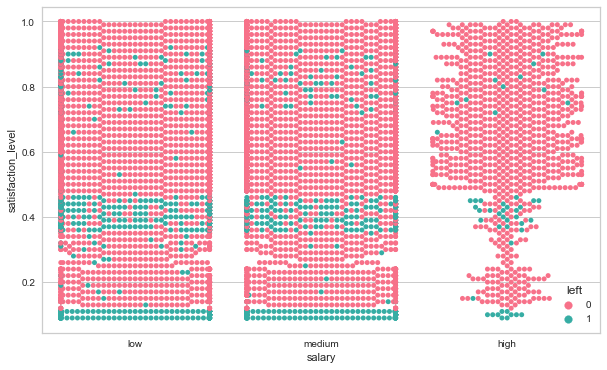

In [69]:
sns.swarmplot(y="satisfaction_level", x="salary", hue="left", data=df, palette="husl");

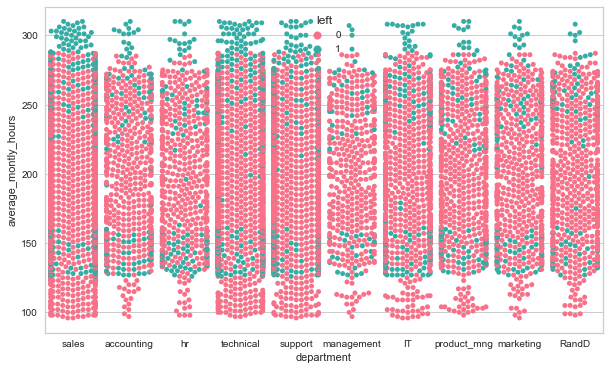

In [70]:
sns.swarmplot(y="average_montly_hours", x="department", hue="left", data=df, palette="husl");

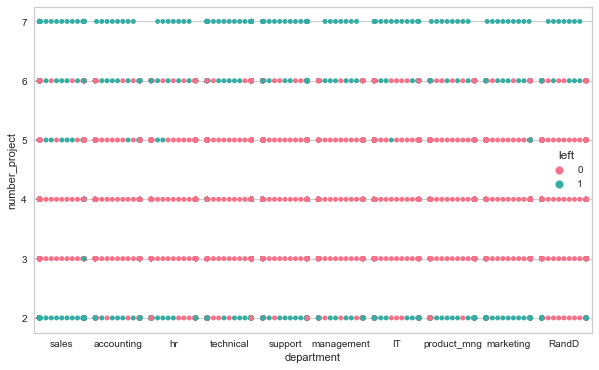

In [71]:
sns.swarmplot(y="number_project", x="department", hue="left", data=df, palette="husl");

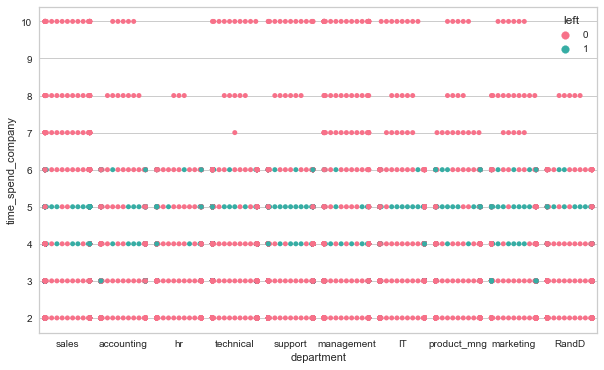

In [72]:
sns.swarmplot(y="time_spend_company", x="department", hue="left", data=df, palette="husl");

In [73]:
for i, col in enumerate(df[categorical].columns):
    xtab = pd.crosstab(df[col], df["left"], normalize=True)
    print(colored('-'*40, 'red', attrs=['bold']), sep='')
    print(xtab*100)

----------------------------------------
left             0     1
department              
IT           6.822 1.318
RandD        5.079 0.709
accounting   4.270 0.909
hr           4.070 0.942
management   3.202 0.434
marketing    4.679 0.934
product_mng  4.804 0.917
sales       22.425 4.587
support     12.584 2.602
technical   15.462 3.252
----------------------------------------
left        0     1
salary             
high    7.856 0.400
low    38.079 9.791
medium 37.461 6.413


### numerical variables

In [74]:
numerical= df.drop(['left'], axis = 1).select_dtypes('number').columns

categorical = df.select_dtypes('object').columns

print('---------------------')
print(f'Numerical Columns:  {df[numerical].columns}')
print(f'Categorical Columns: {df[categorical].columns}')
print('---------------------')

---------------------
Numerical Columns:  Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years'],
      dtype='object')
Categorical Columns: Index(['department', 'salary'], dtype='object')
---------------------


In [75]:
df[numerical].describe().T.style.background_gradient(subset = ['mean','std','50%','count'], cmap = 'RdPu')

,count,mean,std,min,25%,50%,75%,max
satisfaction_level,11991.000000,0.629658,0.241070,0.090000,0.480000,0.660000,0.820000,1.000000
last_evaluation,11991.000000,0.716683,0.168343,0.360000,0.570000,0.720000,0.860000,1.000000
number_project,11991.000000,3.802852,1.163238,2.000000,3.000000,4.000000,5.000000,7.000000
average_montly_hours,11991.000000,200.473522,48.727813,96.000000,157.000000,200.000000,243.000000,310.000000
time_spend_company,11991.000000,3.364857,1.330240,2.000000,3.000000,3.000000,4.000000,10.000000
work_accident,11991.000000,0.154282,0.361234,0.000000,0.000000,0.000000,0.000000,1.000000
promotion_last_5years,11991.000000,0.016929,0.129012,0.000000,0.000000,0.000000,0.000000,1.000000


In [76]:
df[numerical].iplot(kind = 'histogram', subplots = True, bins = 50)

In [77]:
for i in numerical:
    df[i].iplot(kind = 'box', title = i, boxpoints = 'all')

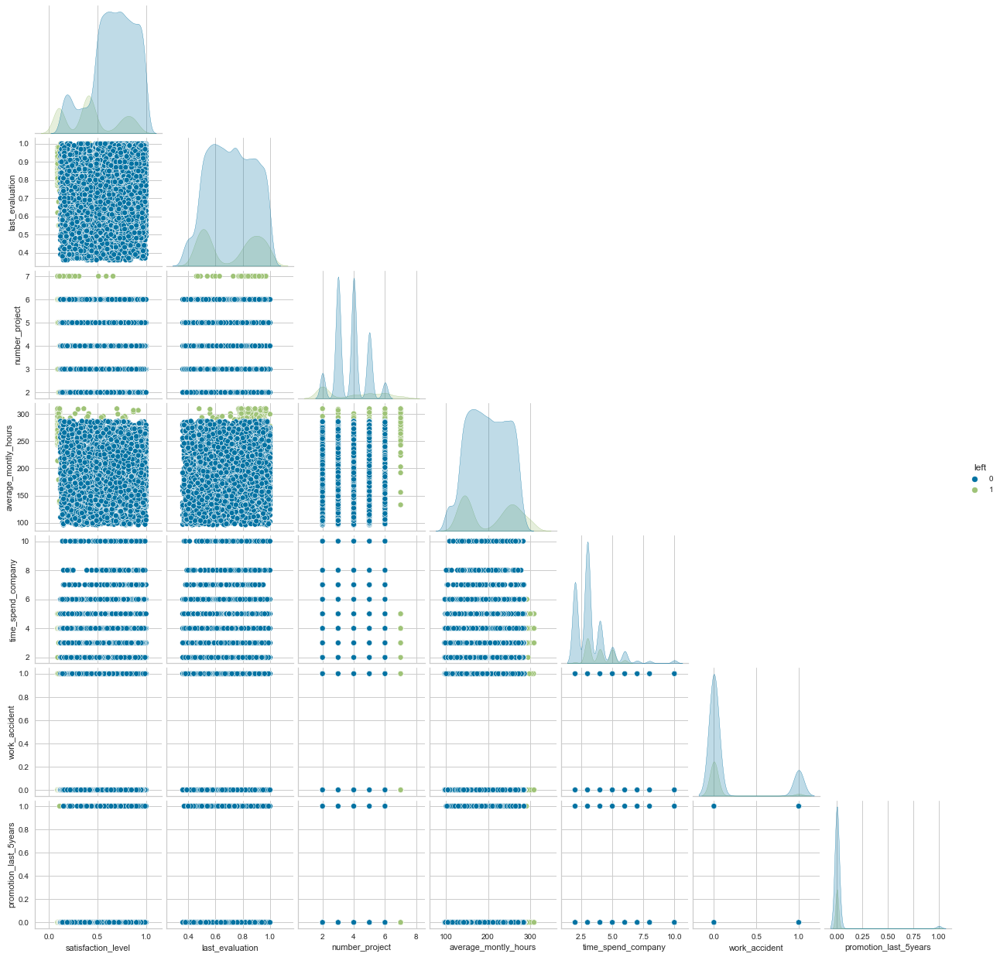

In [78]:
sns.pairplot(df, hue = "left", corner = True);

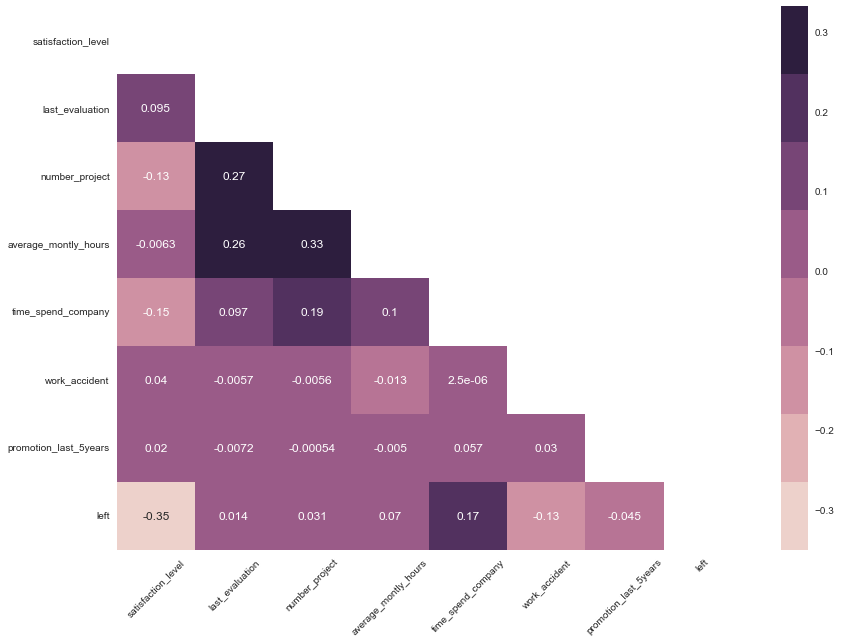

In [79]:
plt.figure(figsize=(14, 10))

# Getting the Upper Triangle of the co-relation matrix
matrix = np.triu(df.corr())

# using the upper triangle matrix as mask 
sns.heatmap(df.corr(), annot=True, cmap = sns.cubehelix_palette(8), mask=matrix)

plt.xticks(rotation=45);

In [80]:
df.corr()['left'].sort_values().drop('left').iplot(kind = 'barh', colors='purple');

In [81]:
df_temp = df.corr()

count = 'Done'
feature =[]
collinear= []
for col in df_temp.columns:
    for i in df_temp.index:
        if (df_temp[col][i] > .9 and df_temp[col][i] < 1) or (df_temp[col][i] < -.9 and df_temp[col][i] > -1) :
                feature.append(col)
                collinear.append(i)
                print(Fore.RED + f'\033[1mmulticolinearity alert in between\033[0m {col} - {i}')
        else:
            print(f'For {col} and {i}, there is NO multicollinearity problem') 

print('\033[1mThe number of strong corelated features:\033[0m', count) 

For satisfaction_level and satisfaction_level, there is NO multicollinearity problem
For satisfaction_level and last_evaluation, there is NO multicollinearity problem
For satisfaction_level and number_project, there is NO multicollinearity problem
For satisfaction_level and average_montly_hours, there is NO multicollinearity problem
For satisfaction_level and time_spend_company, there is NO multicollinearity problem
For satisfaction_level and work_accident, there is NO multicollinearity problem
For satisfaction_level and promotion_last_5years, there is NO multicollinearity problem
For satisfaction_level and left, there is NO multicollinearity problem
For last_evaluation and satisfaction_level, there is NO multicollinearity problem
For last_evaluation and last_evaluation, there is NO multicollinearity problem
For last_evaluation and number_project, there is NO multicollinearity problem
For last_evaluation and average_montly_hours, there is NO multicollinearity problem
For last_evaluatio

In [82]:
df.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years', 'department', 'salary', 'left'],
      dtype='object')

Based on the examinations made above;
- There is no multicollinearity problem among the features.
- We have weak level correlation between the numerical features and the target column.
- Also there is weak level correlation between the columns.
- Target variable demonstrates a slight negative correlation with the variables of "satisfaction_level", "promotion_last_5years" and 'work_accident',
- Target variable of "left" demonstrates weak correlation with the variables of 'last_evaluation', 'number_project', 'average_montly_hours', 'time_spend_company', 'department' and 'salary'.
- "satisfaction_level", even if it's quite small, has more influence on the decision to leave work with a negative value than other features.
- The increase in spending time at workplace positively affects the decision to leave with the company.

In [83]:
# df = pd.read_csv('data.csv')
# df.head()

## 5) DATA VISUALIZATION


- Employees Left
- Determine Number of Projects
- Determine Time Spent in Company

### - Subplots of Features
You can search for answers to the following questions using data visualization methods. Based on these responses, you can develop comments about the factors that cause churn.

- How does the promotion status affect employee churn?
- How does years of experience affect employee churn?
- How does workload affect employee churn?
- How does the salary level affect employee churn?

### A General Look at the Data
Let's check how many employees were left?
Here, you can plot a bar graph using Matplotlib. The bar graph is suitable for showing discrete variable counts.

In [84]:
cprint('"left" Column Distribution','green')
df.left.value_counts()

"left" Column Distribution


0    10000
1     1991
Name: left, dtype: int64

In [85]:
# with plotly

df['left'].value_counts().iplot(kind="bar", title = '"left" Column Distribution')

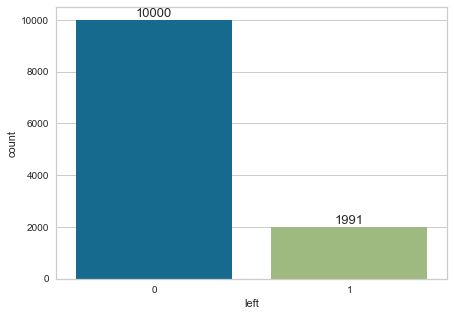

In [86]:
# with seaborn

plt.figure(figsize = (7,5))
sns.countplot(data = df, x = 'left');
for index,value in enumerate(df.left.value_counts()):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13);

"left" Column Distribution


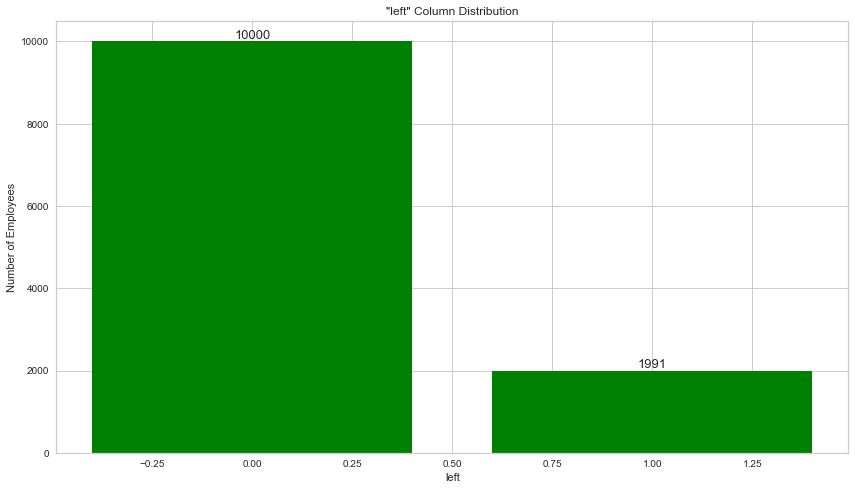

In [87]:
cprint('"left" Column Distribution','green')
fig = plt.figure(figsize = (11, 6))
ax = fig.add_axes([0, 0, 1, 1])
ax.bar(df.left.value_counts().index, df.left.value_counts().values, color = 'green')
plt.title('"left" Column Distribution')   
plt.xlabel('left') 
plt.ylabel('Number of Employees') 
for index,value in enumerate(df.left.value_counts()):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13)
plt.show()

## 5.2 - Number of Projects
Similarly, you can also plot a bar graph to count the number of employees deployed on how many projects?

In [88]:
cprint('"number_project" Column Distribution','green')
df.number_project.value_counts()

"number_project" Column Distribution


4    3685
3    3520
5    2233
2    1582
6     826
7     145
Name: number_project, dtype: int64

In [89]:
# with plotly

df['number_project'].value_counts().iplot(kind="bar", title = '"number_project" Column Distribution')

"number_project" Column Distribution


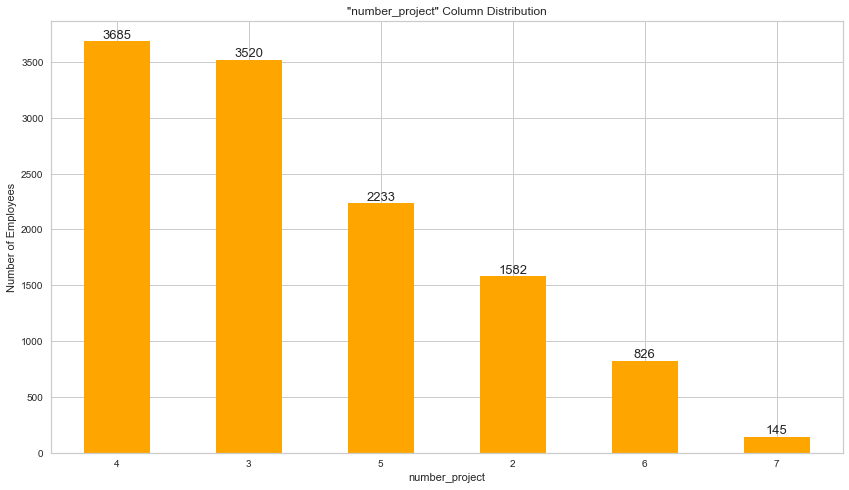

In [90]:
cprint('"number_project" Column Distribution','green')
fig = plt.figure(figsize = (11,6))
ax = fig.add_axes([0,0,1,1])
# x = df.number_project.value_counts().index
# y = df.number_project.value_counts().values
df.number_project.value_counts().plot(kind = "bar", color = "orange")
plt.title('"number_project" Column Distribution')   
plt.xlabel('number_project') 
plt.ylabel('Number of Employees')
plt.xticks(rotation = 0)
for index,value in enumerate(df.number_project.value_counts().sort_values(ascending=False)):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13)
plt.show()

### 5.3 - Time Spent in the Company
Similarly, you can also plot a bar graph to count the number of employees have based on how much experience?

In [91]:
cprint('"time_spend_company" Column Distribution','green')
df.time_spend_company.value_counts()

"time_spend_company" Column Distribution


3     5190
2     2910
4     2005
5     1062
6      542
10     107
7       94
8       81
Name: time_spend_company, dtype: int64

In [92]:
# with plotly

df['time_spend_company'].value_counts().iplot(kind="bar", title = '"time_spend_company" Column Distribution')

"time_spend_company" Column Distribution


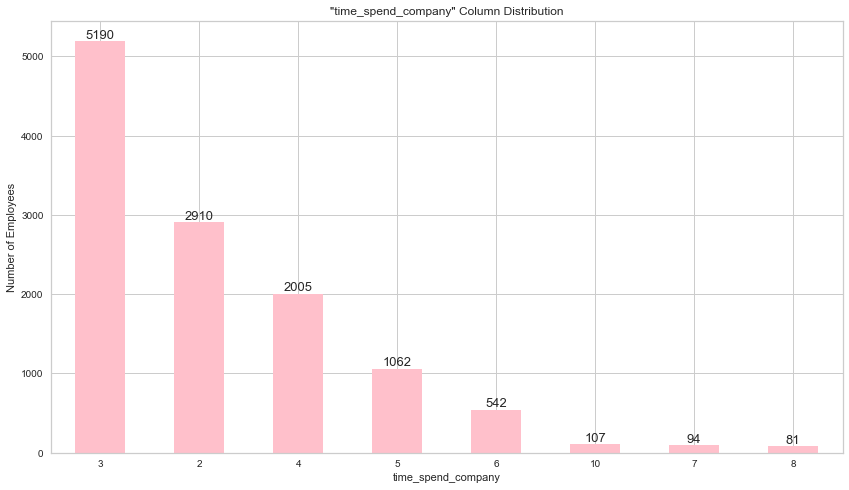

In [93]:
cprint('"time_spend_company" Column Distribution','green')
fig = plt.figure(figsize = (11,6))
ax = fig.add_axes([0,0,1,1])
df.time_spend_company.value_counts().plot(kind = "bar", color = "pink")
plt.title('"time_spend_company" Column Distribution')   
plt.xlabel('time_spend_company') 
plt.ylabel('Number of Employees')
plt.xticks(rotation = 0)
for index,value in enumerate(df.time_spend_company.value_counts().sort_values(ascending=False)):
    plt.text(index, value, f'{value}', ha = 'center', va = 'bottom', fontsize = 13)
plt.show()

### 5.4 - Subplots of Features
You can use the methods of the matplotlib.

In [94]:
for i in df:
    df[i].iplot(kind = 'histogram', subplots = True, bins = 50)

## 6) DATA PRE-PROCESSING
Tasks in this section
- Label Encoding
- Scaling

### 6.1 - Label Encoding
Lots of machine learning algorithms require numerical input data, so you need to represent categorical columns in a numerical column. In order to encode this data, you could map each value to a number. e.g. Salary column's value can be represented as low:0, medium:1, and high:2. This process is known as label encoding, and sklearn conveniently will do this for you using LabelEncoder.

In [95]:
df1 = df.drop('left', axis = 1)
df1.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department,salary
0,0.380,0.530,2,157,3,0,0,sales,low
1,0.800,0.860,5,262,6,0,0,sales,medium
2,0.110,0.880,7,272,4,0,0,sales,medium
3,0.720,0.870,5,223,5,0,0,sales,low
4,0.370,0.520,2,159,3,0,0,sales,low


In [96]:
df1 = pd.get_dummies(df1, columns = ['department','salary'], drop_first = True)
df1.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department_RandD,department_accounting,department_hr,department_management,department_marketing,department_product_mng,department_sales,department_support,department_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,0,0,0,0,0,0,1,0,0,1,0


### 6.2 - Scalling
Some machine learning algorithms are sensitive to feature scaling while others are virtually invariant to it. Machine learning algorithms like linear regression, logistic regression, neural network, etc. that use gradient descent as an optimization technique require data to be scaled. Also distance algorithms like KNN, K-means, and SVM are most affected by the range of features. This is because behind the scenes they are using distances between data points to determine their similarity.

Scaling Types & Selecting Scaler:
Min-Max Scaler (Normalization) : Normalization is a scaling technique in which values are shifted and rescaled so that they end up ranging between 0 and 1. This Scaler responds well if the standard deviation is small and when a distribution is not Gaussian. This Scaler is sensitive to outliers. It is also known as Normalization.

Standard Scaler : Standardization is another scaling technique where the values are centered around the mean with a unit standard deviation. This means that the mean of the attribute becomes zero and the resultant distribution has a unit standard deviation. Assumes that data is normally distributed within each feature and scales them such that the distribution centered around 0, with a standard deviation of 1.

Max Abs Scaler : Scale each feature by its maximum absolute value. This estimator scales and translates each feature individually such that the maximal absolute value of each feature in the training set is 1.0. It does not shift/center the data and thus does not destroy any sparsity. On positive-only data, this Scaler behaves similarly to Min Max Scaler and, therefore, also suffers from the presence of significant outliers.

Robust Scaler : Robust to outliers. If our data contains many outliers, scaling using the mean and standard deviation of the data won’t work well. This Scaler removes the median and scales the data according to the quantile range. The centering and scaling statistics of this Scaler are based on percentiles and are therefore not influenced by a few numbers of huge marginal outliers.

Quantile Transformer Scaler : Transform features using quantiles information. This method transforms the features to follow a uniform or a normal distribution. Therefore, for a given feature, this transformation tends to spread out the most frequent values. It also reduces the impact of (marginal) outliers: this is, therefore, a robust pre-processing scheme. The cumulative distribution function of a feature is used to project the original values. Note that this transform is non-linear and may distort linear correlations between variables measured at the same scale but renders variables measured at different scales more directly comparable. This is also sometimes called as Rank scaler.

Power Transformer Scaler : The power transformer is a family of parametric, monotonic transformations that are applied to make data more Gaussian-like. This is useful for modeling issues related to the variability of a variable that is unequal across the range (heteroscedasticity) or situations where normality is desired. The power transform finds the optimal scaling factor in stabilizing variance and minimizing skewness through maximum likelihood estimation. Currently, Sklearn implementation of PowerTransformer supports the Box-Cox transform and the Yeo-Johnson transform. The optimal parameter for stabilizing variance and minimizing skewness is estimated through maximum likelihood. Box-Cox requires input data to be strictly positive, while Yeo-Johnson supports both positive or negative data.

Unit Vector Scaler : Scaling is done considering the whole feature vector to be of unit length. This usually means dividing each component by the Euclidean length of the vector (L2 Norm). In some applications (e.g., histogram features), it can be more practical to use the L1 norm of the feature vector. Like Min-Max Scaling, the Unit Vector technique produces values of range [0,1]. When dealing with features with hard boundaries, this is quite useful. For example, when dealing with image data, the colors can range from only 0 to 255.

In [97]:
df1.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department_RandD,department_accounting,department_hr,department_management,department_marketing,department_product_mng,department_sales,department_support,department_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,0,0,0,0,0,0,1,0,0,1,0


In [98]:
scaler = MinMaxScaler()
scaler.fit(df1)

#Store it separately for clustering
df1_scaled= scaler.transform(df1)

In [99]:
df1_scaled

array([[0.31868132, 0.265625  , 0.        , ..., 0.        , 1.        ,
        0.        ],
       [0.78021978, 0.78125   , 0.6       , ..., 0.        , 0.        ,
        1.        ],
       [0.02197802, 0.8125    , 1.        , ..., 0.        , 0.        ,
        1.        ],
       ...,
       [0.83516484, 0.28125   , 0.2       , ..., 0.        , 0.        ,
        0.        ],
       [0.26373626, 0.453125  , 0.2       , ..., 0.        , 0.        ,
        0.        ],
       [0.45054945, 0.578125  , 0.4       , ..., 0.        , 1.        ,
        0.        ]])

## 7) CLUSTER ANALYSIS
- Find the optimal number of clusters (k) using the elbow method for for K-means.

- Determine the clusters by using K-Means then Evaluate predicted results.
- Cluster analysis or clustering is the task of grouping a set of objects in such a way that objects in the same group (called a cluster) are more similar (in some sense) to each other than to those in other groups (clusters). It is a main task of exploratory data mining, and a common technique for statistical data analysis, used in many fields, including pattern recognition, image analysis, information retrieval, bioinformatics, data compression, computer graphics and machine learning.

For a better understanding and more information, please refer to SOURCE 1 and SOURCE 2

Does Cluster make sense for our data?
  1. Does our data already have a potential class label?

  Using the existing class label in our data is often better than trying to create a new label for your data from clustering. If we have the option, supervised machine learning almost always outperforms unsupervised learning in classification tasks. If we have data but have no way to organize the data into meaningful groups, then clustering makes sense. But if we already have an intuitive class label in your data set, then the labels created by a clustering analysis may not perform as well as the original class label.

  2. Is our data categorical or continuous?

  Many clustering algorithms (like DBSCAN or K-Means) use a distance measurement to calculate the similarity between observations. Because of this, certain clustering algorithms will perform better with continuous attributes. However, if we have categorical data, you can one-hot encode the attributes or use a clustering algorithm built for categorical data, such as K-Modes. It should be noted that it does not make a lot of sense to calculate distance between binary variables. Knowing how different clustering algorithms perform on different data types is essential for deciding if clustering makes sense for our data.

  3. What does our data look like?

  A simple visualization of your data with a scatter plot can provide insights into whether your data is well suited for clustering. If visualization reveals that our data has no amount of separation or distinct groups, then clustering may not be appropriate.

  4. Do we have a way to validate our clustering algorithm?

  In order to trust the clustering algorithm results, we must have a method for measuring the algorithm's performance. Clustering algorithm performance can be validated with either internal or external validation metrics.

An example of internal validation is the silhouette score, a way to measure how well each observation is clustered (1.0 is perfect, 0.0 is worst).

An example of external validation is when the class label for a data set is already known, but we want to test how well a particular clustering algorithm performs on predicting the existing classes. A noteworthy caveat to the external validation approach is that there is not a huge use case for clustering if the data already has class labels! To have confidence in our machine learning model, we must have a consistent metric for measuring model performance. Clustering is no different. We must have a way to quantitatively assess how well the model is clustering the data.

Before conducting a clustering analysis, we consider which type of validation and which metric makes the most sense for our data. Some algorithms may perform deceivingly well with certain validation metrics, so we may need to use a combination of performance metrics to negate this issue. If we consistently achieve poor model performance, then clustering is not a good fit for your data.
  5. Does clustering provide any new insight into the data?

  Let’s say that we meet all the above considerations:

We have continuous data with no class label
We visualize the data and there is some separation
We choose a validation metric that makes sense for our analysis
We run a clustering algorithm on the data and obtain a reasonably high silhouette score
our work is not done. After performing a clustering analysis, it is crucial to examine the observations in the individual clusters. This step allows us to assess whether or not the clusters provide any new insight into the data. Did the algorithm really find similar groups of observations and maximize intraclass similarity while minimizing between cluster similarity? An easy way to examine clusters is to calculate simple statistics for the observations in each cluster, such as the mean. If clustering fails to produce any new or useful insights into our data, then our data is not well suited for clustering.

Click here for more on 'When Clustering Doesn’t Make Sense'.

The Elbow Method
- "Elbow Method" can be used to find the optimum number of clusters in cluster analysis. The elbow method is used to determine the optimal number of clusters in k-means clustering. The elbow method plots the value of the cost function produced by different values of k. If k increases, average distortion will decrease, each cluster will have fewer constituent instances, and the instances will be closer to their respective centroids. However, the improvements in average distortion will decline as k increases. The value of k at which improvement in distortion declines the most is called the elbow, at which we should stop dividing the data into further clusters.

For a better understanding and more information, please refer to The Elbow Method SOURCE 1), The Elbow Method SOURCE 2 and KMeans SOURCE 1

Let's find out the groups of employees who left. You can observe that the most important factor for any employee to stay or leave is satisfaction and performance in the company. So let's bunch them in the group of people using cluster analysis.

In [100]:
from pyclustertend import hopkins

hopkins(df1_scaled, df1.shape[0])

0.08269187945613282

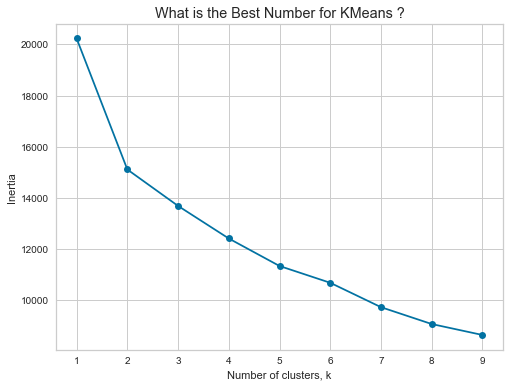

In [101]:
#First : Get the Best KMeans 
ks = range(1,10)
inertias=[]
for k in ks :
    # Create a KMeans clusters
    kc = KMeans(n_clusters=k,random_state=1)
    kc.fit(df1_scaled)
    inertias.append(kc.inertia_)

# Plot ks vs inertias
f, ax = plt.subplots(figsize=(8, 6))
plt.plot(ks, inertias, '-o')
plt.xlabel('Number of clusters, k')
plt.ylabel('Inertia')
plt.xticks(ks)
plt.style.use('ggplot')
plt.title('What is the Best Number for KMeans ?')
plt.show()

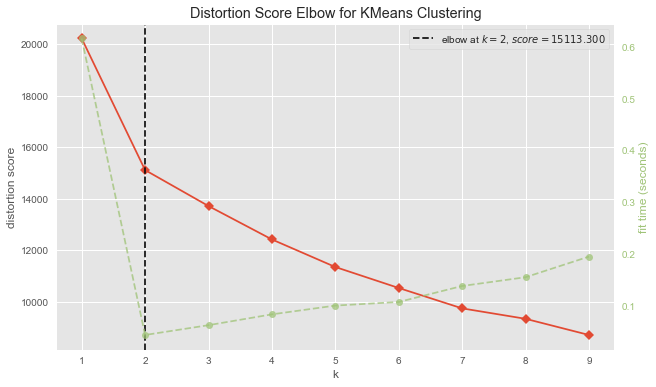

In [102]:
from yellowbrick.cluster import KElbowVisualizer

kmeans = KMeans()
visu = KElbowVisualizer(kmeans, k = (1,10))
visu.fit(df1_scaled)
visu.show();

In [103]:
from sklearn.metrics import silhouette_samples,silhouette_score

ssd =[]

K = range(2, 10)

for k in K:
    model = KMeans(n_clusters=k)
    model.fit(df1_scaled)
    ssd.append(model.inertia_)
    print(f'Silhouette Score for {k} clusters: {silhouette_score(df1_scaled, model.labels_)}')

Silhouette Score for 2 clusters: 0.24293849820807237
Silhouette Score for 3 clusters: 0.19250986825854602
Silhouette Score for 4 clusters: 0.18041466053129487
Silhouette Score for 5 clusters: 0.21174582903978412
Silhouette Score for 6 clusters: 0.2421202673940679
Silhouette Score for 7 clusters: 0.27074139305914324
Silhouette Score for 8 clusters: 0.28545771823258026
Silhouette Score for 9 clusters: 0.2979336597866149


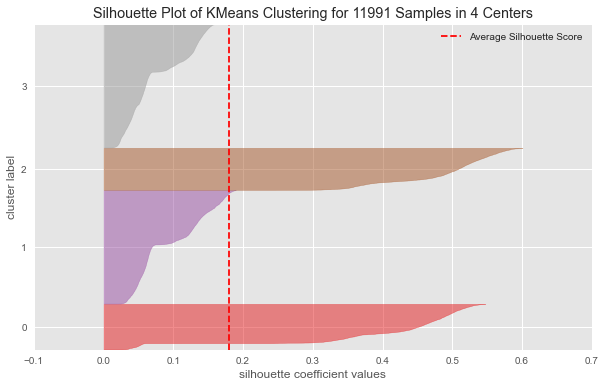

In [104]:
from sklearn.cluster import KMeans

from yellowbrick.cluster import SilhouetteVisualizer

model_4 = KMeans(n_clusters=4, random_state=101)
visualizer = SilhouetteVisualizer(model_4)
visualizer.fit(df1_scaled)    # Fit the data to the visualizer
visualizer.poof();

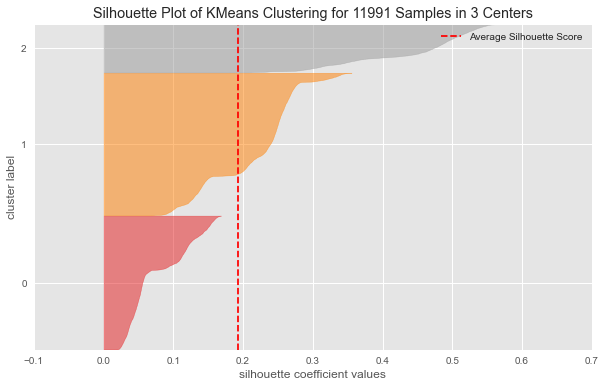

In [105]:
from sklearn.cluster import KMeans

from yellowbrick.cluster import SilhouetteVisualizer

model_3 = KMeans(n_clusters=3, random_state=101)
visualizer = SilhouetteVisualizer(model_3)
visualizer.fit(df1_scaled)    # Fit the data to the visualizer
visualizer.poof();

In [106]:
k_means_model = KMeans(n_clusters = 3, random_state = 101)
k_means_model.fit_predict(df1_scaled)
labels = k_means_model.labels_
labels

array([2, 1, 1, ..., 0, 0, 0])

In [107]:
df['predicted_clusters'] = labels
df

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department,salary,left,predicted_clusters
0,0.380,0.530,2,157,3,0,0,sales,low,1,2
1,0.800,0.860,5,262,6,0,0,sales,medium,1,1
2,0.110,0.880,7,272,4,0,0,sales,medium,1,1
3,0.720,0.870,5,223,5,0,0,sales,low,1,2
4,0.370,0.520,2,159,3,0,0,sales,low,1,2
...,...,...,...,...,...,...,...,...,...,...,...
11986,0.900,0.550,3,259,10,1,1,management,high,0,0
11987,0.740,0.950,5,266,10,0,1,management,high,0,0
11988,0.850,0.540,3,185,10,0,1,management,high,0,0
11989,0.330,0.650,3,172,10,0,1,marketing,high,0,0


In [108]:
df['predicted_clusters'].value_counts()

1    5261
0    4940
2    1790
Name: predicted_clusters, dtype: int64

In [109]:
fig = px.pie(df, values = df['predicted_clusters'].value_counts(), 
             names = (df['predicted_clusters'].value_counts()).index, 
             title = 'Predicted_Clusters Distribution')
fig.show()

In [110]:
fig = px.pie(df, values = df[df['left']==0]['predicted_clusters'].value_counts(), 
             names = df[df['left']==0]['predicted_clusters'].value_counts().index, 
             title = 'Predicted_Clusters_Almost_Lost Distribution')
fig.show()

In [111]:
fig = px.pie(df, values = df[df['left']==1]['predicted_clusters'].value_counts(), 
             names = df[df['left']==1]['predicted_clusters'].value_counts().index, 
             title = 'Predicted_Clusters_Almost_Lost Distribution')
fig.show()

In [112]:
pd.crosstab(df['left'], 
            df['predicted_clusters']).iplot(kind="bar", title = 'Compare (left vs predicted-clusters)',
            xTitle = 'left & clusters', yTitle = 'counts')

In [113]:
df.groupby('left').mean()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,predicted_clusters
left,,,,,,,,
0,0.667,0.716,3.787,198.943,3.262,0.174,0.019,0.741
1,0.440,0.722,3.883,208.162,3.881,0.053,0.004,0.719


In [114]:
# cprint('Dataset describe results according to the "left==1" condition','green')

df.groupby(['left', 'predicted_clusters']).mean()

satisfaction_level  last_evaluation  number_project  \
left predicted_clusters                                                        
0    0                                0.667            0.720           3.787   
     1                                0.668            0.715           3.787   
     2                                0.667            0.707           3.787   
1    0                                0.430            0.721           3.912   
     1                                0.440            0.725           3.921   
     2                                0.470            0.716           3.719   

                         average_montly_hours  time_spend_company  \
left predicted_clusters                                             
0    0                                199.074               3.232   
     1                                199.016               3.304   
     2                                198.353               3.215   
1    0                                208.102               3.888   
     1                                209.765               3.891   
     2                                204.601               3.843   

                         work_accident  promotion_last_5years  
left predicted_clusters                                        
0    0                           0.184                  0.015  
     1                           0.169                  0.026  
     2                           0.168                  0.011  
1    0                           0.049                  0.003  
     1                           0.062                  0.004  
     2                           0.039                  0.006

In [115]:
pd.crosstab(df['predicted_clusters'], 
            df['left']).iplot(kind="bar", title = 'Compare (predicted-clusters vs left)',
            xTitle = 'clusters & left', yTitle = 'counts')

In [116]:
df.left.value_counts()

0    10000
1     1991
Name: left, dtype: int64

In [117]:
# cprint('Dataset describe results according to the "left==1" condition','green')

df.groupby('predicted_clusters').mean()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,left
predicted_clusters,,,,,,,,
0,0.624,0.720,3.810,200.702,3.350,0.159,0.013,0.180
1,0.635,0.717,3.806,200.587,3.390,0.153,0.023,0.146
2,0.631,0.708,3.774,199.508,3.331,0.144,0.010,0.185


In [118]:
# cprint('Dataset describe results according to the "left==1" condition','green')

df.groupby(['predicted_clusters', 'left']).mean()

satisfaction_level  last_evaluation  number_project  \
predicted_clusters left                                                        
0                  0                  0.667            0.720           3.787   
                   1                  0.430            0.721           3.912   
1                  0                  0.668            0.715           3.787   
                   1                  0.440            0.725           3.921   
2                  0                  0.667            0.707           3.787   
                   1                  0.470            0.716           3.719   

                         average_montly_hours  time_spend_company  \
predicted_clusters left                                             
0                  0                  199.074               3.232   
                   1                  208.102               3.888   
1                  0                  199.016               3.304   
                   1                  209.765               3.891   
2                  0                  198.353               3.215   
                   1                  204.601               3.843   

                         work_accident  promotion_last_5years  
predicted_clusters left                                        
0                  0             0.184                  0.015  
                   1             0.049                  0.003  
1                  0             0.169                  0.026  
                   1             0.062                  0.004  
2                  0             0.168                  0.011  
                   1             0.039                  0.006

## 8) MODEL BUILDING


- Split Data as Train and Test set
- Built Gradient Boosting Classifier, Evaluate Model Performance and Predict Test Data
- Built K Neighbors Classifier and Evaluate Model Performance and Predict Test Data

- Built Random Forest Classifier and Evaluate Model Performance and Predict Test Data
Evaluating Model Performance
- Confusion Matrix: You can use scikit-learn metrics module for accuracy calculation. A Confusion matrix is an N x N matrix used for evaluating the performance of a classification model, where N is the number of target classes. The matrix compares the actual target values with those predicted by the machine learning model. This gives us a holistic view of how well our classification model is performing and what kinds of errors it is making.

For a better understanding and more information, please refer to Confusion Matrix

- Yellowbrick: Yellowbrick is a suite of visualization and diagnostic tools that will enable quicker model selection. It’s a Python package that combines scikit-learn and matplotlib. Some of the more popular visualization tools include model selection, feature visualization, classification and regression visualization

For a better understanding and more information, please refer to Yellowbrick

Here, Dataset is broken into two parts in ratio of 70:30. It means 70% data will used for model training and 30% for model testing.

In [119]:
df2 = df.drop('predicted_clusters', axis = 1)
df2.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department,salary,left
0,0.380,0.530,2,157,3,0,0,sales,low,1
1,0.800,0.860,5,262,6,0,0,sales,medium,1
2,0.110,0.880,7,272,4,0,0,sales,medium,1
3,0.720,0.870,5,223,5,0,0,sales,low,1
4,0.370,0.520,2,159,3,0,0,sales,low,1


In [120]:
df2 = pd.get_dummies(df2, columns = ['department','salary'], drop_first = True)
df2.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,left,department_RandD,department_accounting,department_hr,department_management,department_marketing,department_product_mng,department_sales,department_support,department_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,1,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,1,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,1,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,1,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,1,0,0,0,0,0,0,1,0,0,1,0


### 8.1 - Spliting Data as Train & Test

In [121]:
X = df2.drop('left', axis = 1)
y = df2['left']

In [122]:
X_train, X_test, y_train, y_test = train_test_split(X, y, stratify = y, test_size = 0.3, random_state = 101)

In [123]:
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [124]:
def eval(model, X_train, X_test):
    y_pred = model.predict(X_test)
    y_pred_train = model.predict(X_train)
    
    print(confusion_matrix(y_test, y_pred))
    print("Test_Set")
    print(classification_report(y_test,y_pred))
    print("Train_Set")
    print(classification_report(y_train,y_pred_train))
    plot_confusion_matrix(model, X_test, y_test, cmap="plasma")

In [125]:
def train_val(y_train, y_train_pred, y_test, y_pred):
    
    scores = {"train_set": {"Accuracy" : accuracy_score(y_train, y_train_pred),
                            "Precision" : precision_score(y_train, y_train_pred),
                            "Recall" : recall_score(y_train, y_train_pred),                          
                            "f1" : f1_score(y_train, y_train_pred)},
    
              "test_set": {"Accuracy" : accuracy_score(y_test, y_pred),
                           "Precision" : precision_score(y_test, y_pred),
                           "Recall" : recall_score(y_test, y_pred),                          
                           "f1" : f1_score(y_test, y_pred)}}
    
    return pd.DataFrame(scores)

### 8.2 - Best Model Scores With PyCaret
PyCaret is an open source low-code machine learning library in Python that aims to reduce the hypothesis to insights cycle time in a ML experiment. It enables data scientists to perform end-to-end experiments quickly and efficiently. In comparison with the other open source machine learning libraries, PyCaret is an alternate low-code library that can be used to perform complex machine learning tasks with only few lines of code. PyCaret is simple and easy to use. All the operations performed in PyCaret are automatically stored in a custom Pipeline that is fully orchestrated for deployment. PyCaret is essentially a Python wrapper around several machine learning libraries and frameworks such as scikit-learn, XGBoost, Microsoft LightGBM, spaCy and many more.

For a better understanding and more information, please refer to SOURCE 1, SOURCE 2, SOURCE 3, SOURCE 1 & SOURCE 4

In [126]:
# !pip install pycaret
# !conda install --user pycaret 
# !pip install git+https://github.com/pycaret/pycaret.git #egg=pycaret

In [127]:
# from pycaret.classification import *

# employee_clf = setup(df2, target = 'left', 
#                      session_id = 123, 
#                      train_size=0.8, 
#                      log_experiment=True, 
#                      log_plots=True, 
#                      experiment_name = 'employee_churn_model')

In [128]:
# best_model_scores = compare_models()

## 8.3 - Gradient Boosting Classifier
### 8.3.1 Model Building

In [129]:
GB_model = GradientBoostingClassifier(random_state = 101)
GB_model.fit(X_train, y_train)
y_pred = GB_model.predict(X_test)
y_train_pred = GB_model.predict(X_train)

GB_model_f1 = f1_score(y_test, y_pred)
GB_model_acc = accuracy_score(y_test, y_pred)
GB_model_recall = recall_score(y_test, y_pred)
GB_model_auc = roc_auc_score(y_test, y_pred)

<IPython.core.display.Javascript object>

### 8.3.2 Evaluating Model Performance

GB_Model
------------------
[[2974   27]
 [  45  552]]
Test_Set
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      3001
           1       0.95      0.92      0.94       597

    accuracy                           0.98      3598
   macro avg       0.97      0.96      0.96      3598
weighted avg       0.98      0.98      0.98      3598

Train_Set
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      6999
           1       0.97      0.93      0.95      1394

    accuracy                           0.98      8393
   macro avg       0.98      0.96      0.97      8393
weighted avg       0.98      0.98      0.98      8393



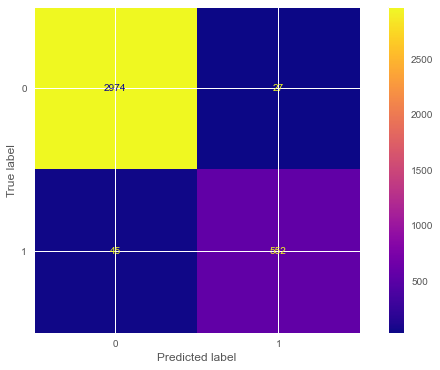

In [130]:
print("GB_Model")
print ("------------------")
eval(GB_model, X_train, X_test)

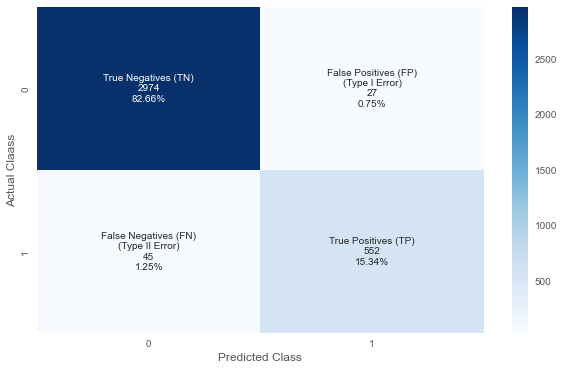

In [131]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

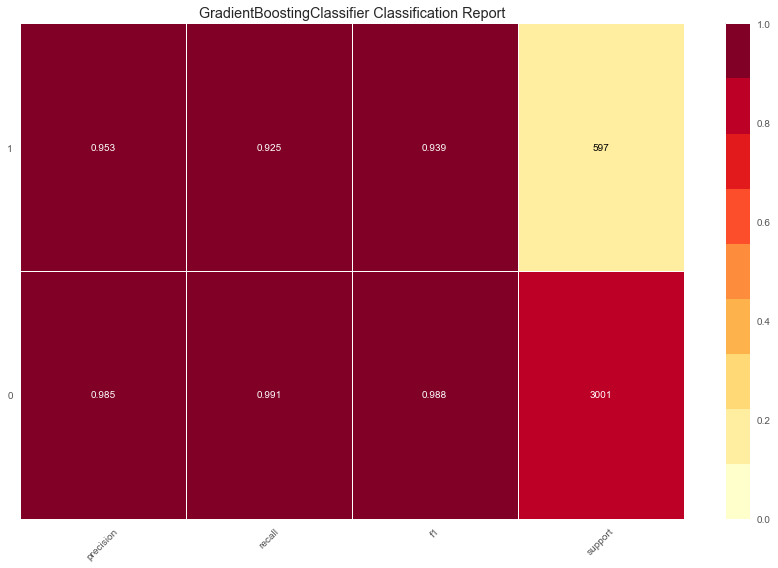

<AxesSubplot:title={'center':'GradientBoostingClassifier Classification Report'}>

In [132]:
plt.figure(figsize=(12, 8))
visualizer = ClassificationReport(GB_model, support=True)
visualizer.fit(X_train, y_train)        # Fit the visualizer and the model
visualizer.score(X_test, y_test)        # Evaluate the model on the test data
visualizer.show()

In [133]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.983,0.980
Precision,0.969,0.953
Recall,0.928,0.925
f1,0.948,0.939


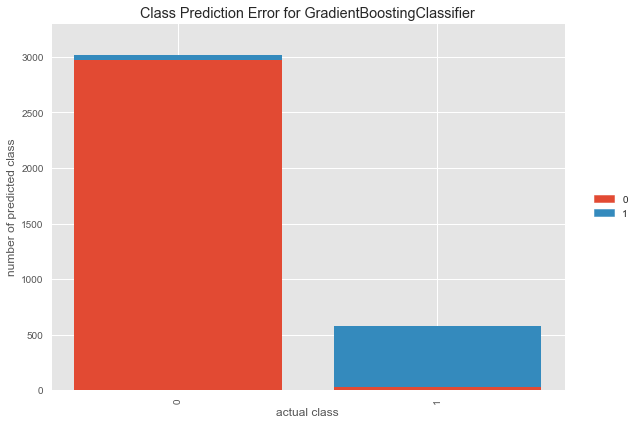

In [134]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(GB_model)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

### 8.3.3 Feature Importance for Gradient Boosting Model

In [135]:
GB_feature_imp = pd.DataFrame(index=X.columns, data = GB_model.feature_importances_, columns = ['Importance']).sort_values("Importance", ascending = False)
GB_feature_imp

,Importance
satisfaction_level,0.527
number_project,0.138
time_spend_company,0.137
last_evaluation,0.122
average_montly_hours,0.075
salary_low,0.001
work_accident,0.000
department_management,0.000
department_product_mng,0.000
department_RandD,0.000


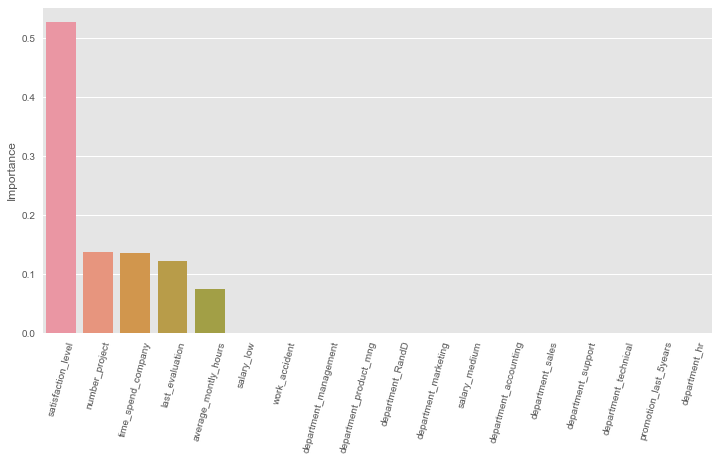

In [136]:
plt.figure(figsize = (12,6))
sns.barplot(data = GB_feature_imp.sort_values('Importance', ascending = False), x = GB_feature_imp.sort_values('Importance', ascending = False).index, y = 'Importance')
plt.xticks(rotation = 75);

### 8.3.4 Gradient Boosting Classifier Cross Validation

In [137]:
GB_cv = GradientBoostingClassifier(random_state = 101)

GB_cv_scores = cross_validate(GB_cv, X_train, y_train, 
                              scoring = ['accuracy', 'precision','recall', 'f1', 'roc_auc'], cv = 10)
GB_cv_scores = pd.DataFrame(GB_cv_scores, index = range(1, 11))

GB_cv_scores.mean()[2:]

<IPython.core.display.Javascript object>

test_accuracy    0.981
test_precision   0.965
test_recall      0.922
test_f1          0.943
test_roc_auc     0.985
dtype: float64

# 8.3.5 Gradient Boosting Classifier GridSearchCV

In [138]:
param_grid = {"n_estimators":[100, 200, 300],
              "subsample":[0.5, 1], 
              "max_features" : [None, 2, 3, 4],
              "learning_rate": [0.001, 0.01, 0.1], 
              'max_depth':[3, 4, 5, 6]} 

In [139]:
GB_grid = GradientBoostingClassifier(random_state = 101)
GB_grid_model = GridSearchCV(GB_grid, param_grid, scoring = "f1", verbose = 0, n_jobs = -1).fit(X_train, y_train)

<IPython.core.display.Javascript object>

In [140]:
GB_grid_model.best_estimator_

GradientBoostingClassifier(learning_rate=0.01, max_depth=6, n_estimators=200,
                           random_state=101, subsample=0.5)

In [141]:
print(colored('\033[1mBest Parameters of GridSearchCV for Gradient Boosting Model:\033[0m', 'blue'), colored(GB_grid_model.best_params_, 'cyan'))
print("--------------------------------------------------------------------------------------------------------------------")
print(colored('\033[1mBest Estimator of GridSearchCV for Gradient Boosting Model:\033[0m', 'blue'), colored(GB_grid_model.best_estimator_, 'cyan'))

Best Parameters of GridSearchCV for Gradient Boosting Model: {'learning_rate': 0.01, 'max_depth': 6, 'max_features': None, 'n_estimators': 200, 'subsample': 0.5}
--------------------------------------------------------------------------------------------------------------------
Best Estimator of GridSearchCV for Gradient Boosting Model: GradientBoostingClassifier(learning_rate=0.01, max_depth=6, n_estimators=200,
                           random_state=101, subsample=0.5)


In [142]:
GB_tuned = GradientBoostingClassifier(learning_rate = 0.01,
                                      max_depth = 6, 
                                      n_estimators = 200,
                                      subsample = 0.5,
                                      random_state = 101).fit(X_train, y_train)

<IPython.core.display.Javascript object>

In [143]:
y_pred = GB_tuned.predict(X_test)
y_train_pred = GB_tuned.predict(X_train)

GB_tuned_f1 = f1_score(y_test, y_pred)
GB_tuned_acc = accuracy_score(y_test, y_pred)
GB_tuned_recall = recall_score(y_test, y_pred)
GB_tuned_auc = roc_auc_score(y_test, y_pred)

GB_tuned
------------------
[[2994    7]
 [  48  549]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      3001
           1       0.99      0.92      0.95       597

    accuracy                           0.98      3598
   macro avg       0.99      0.96      0.97      3598
weighted avg       0.98      0.98      0.98      3598

Train_Set
              precision    recall  f1-score   support

           0       0.99      1.00      0.99      6999
           1       0.99      0.93      0.96      1394

    accuracy                           0.99      8393
   macro avg       0.99      0.96      0.97      8393
weighted avg       0.99      0.99      0.99      8393



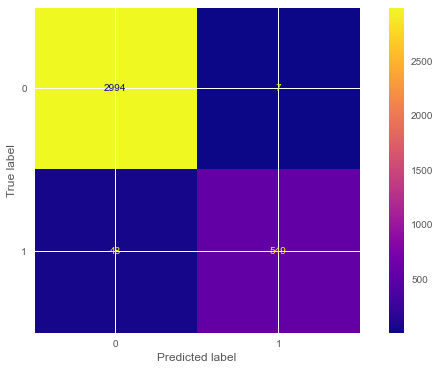

In [144]:
print("GB_tuned")
print ("------------------")
eval(GB_tuned, X_train, X_test)

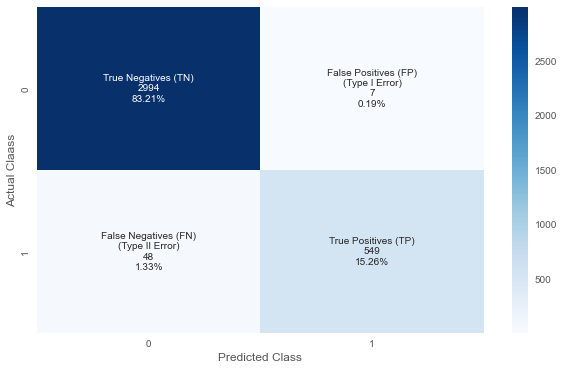

In [145]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

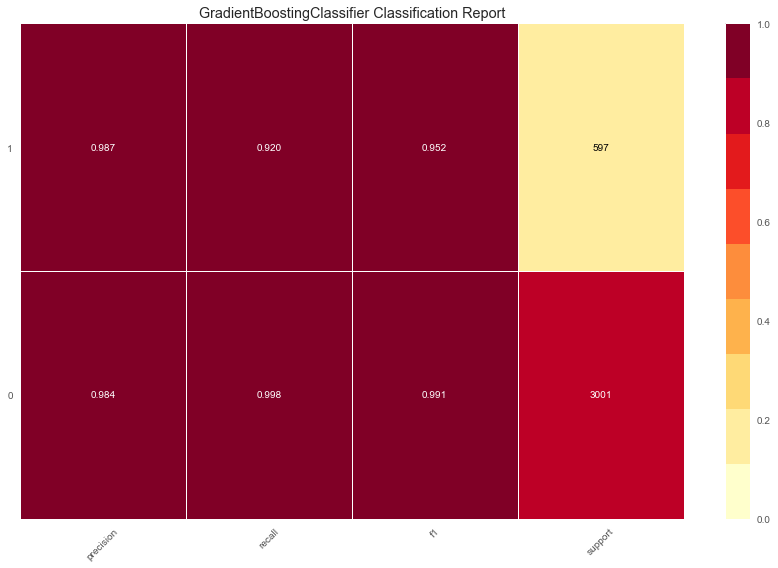

<AxesSubplot:title={'center':'GradientBoostingClassifier Classification Report'}>

In [146]:
plt.figure(figsize=(12, 8))
visualizer = ClassificationReport(GB_tuned, support=True)
visualizer.fit(X_train, y_train)        # Fit the visualizer and the model
visualizer.score(X_test, y_test)        # Evaluate the model on the test data
visualizer.show()

In [147]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.986,0.985
Precision,0.989,0.987
Recall,0.926,0.920
f1,0.957,0.952


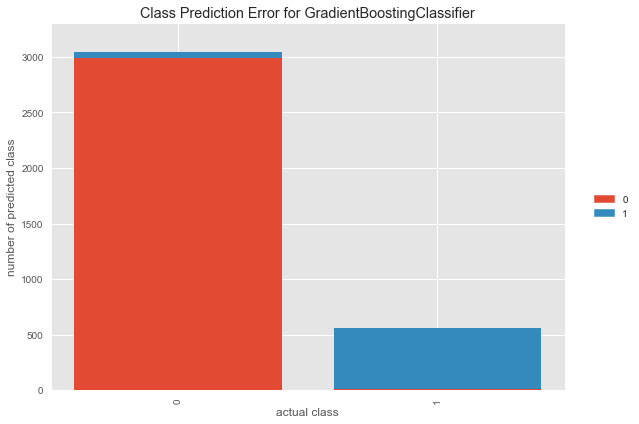

In [148]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(GB_tuned)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

### 8.3.6 Gradient Boosting Classifier ROC (Receiver Operating Curve) & AUC (Area Under Curve)

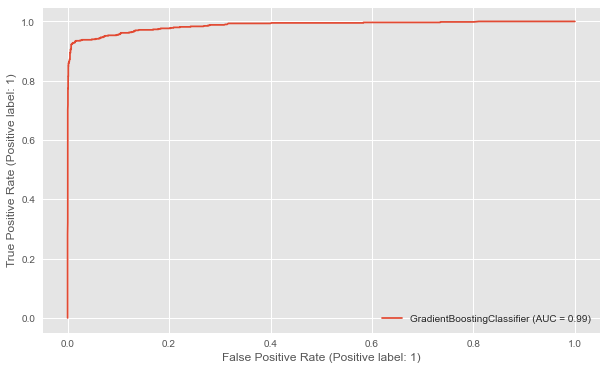

In [149]:
plot_roc_curve(GB_model, X_test, y_test);

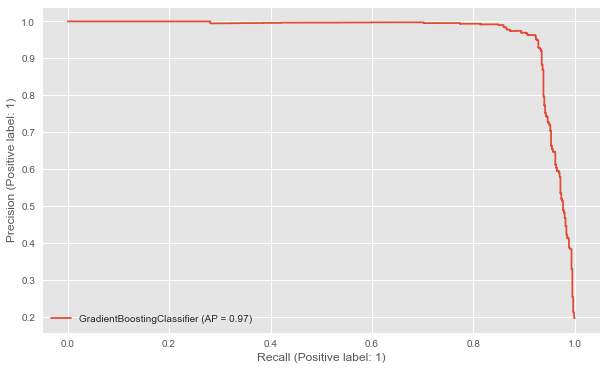

In [150]:
plot_precision_recall_curve(GB_model, X_test, y_test);

### 8.3.7 Prediction

In [151]:
GB_Pred = {"Actual": y_test, "GB_Pred":y_pred}
GB_Pred = pd.DataFrame.from_dict(GB_Pred)
GB_Pred.head(20)

,Actual,GB_Pred
3109,0,0
10481,0,0
1104,1,1
3813,0,0
6864,0,0
9572,0,0
9703,0,0
8785,0,0
4821,0,0
179,1,1


In [152]:
Model_Preds = GB_Pred
Model_Preds.head()

,Actual,GB_Pred
3109,0,0
10481,0,0
1104,1,1
3813,0,0
6864,0,0


## 8.4 - KNeighbors Classifier
### 8.4.1 Model Building

In [153]:
KNN_model = KNeighborsClassifier(n_neighbors = 5)
KNN_model.fit(X_train, y_train)
y_pred = KNN_model.predict(X_test)
y_train_pred = KNN_model.predict(X_train)

KNN_model_f1 = f1_score(y_test, y_pred)
KNN_model_acc = accuracy_score(y_test, y_pred)
KNN_model_recall = recall_score(y_test, y_pred)
KNN_model_auc = roc_auc_score(y_test, y_pred)

### 8.4.2 Evaluating Model Performance

KNN_Model
------------------
[[2883  118]
 [  83  514]]
Test_Set
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      3001
           1       0.81      0.86      0.84       597

    accuracy                           0.94      3598
   macro avg       0.89      0.91      0.90      3598
weighted avg       0.95      0.94      0.94      3598

Train_Set
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      6999
           1       0.88      0.88      0.88      1394

    accuracy                           0.96      8393
   macro avg       0.93      0.93      0.93      8393
weighted avg       0.96      0.96      0.96      8393



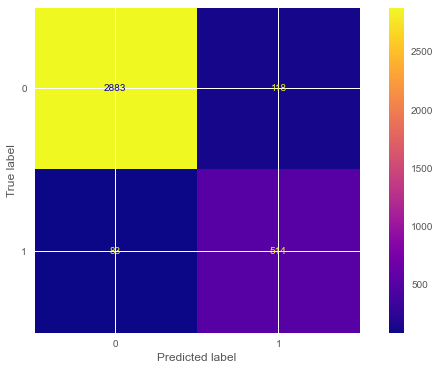

In [154]:
print("KNN_Model")
print ("------------------")
eval(KNN_model, X_train, X_test)

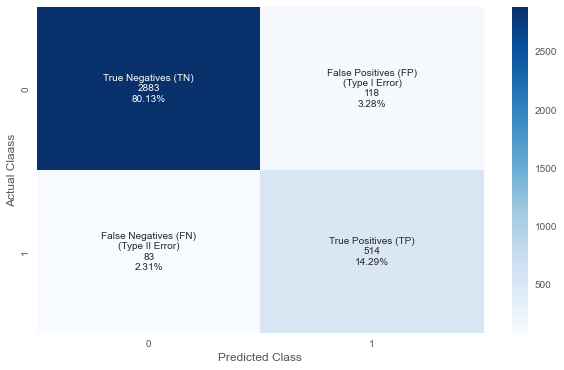

In [155]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

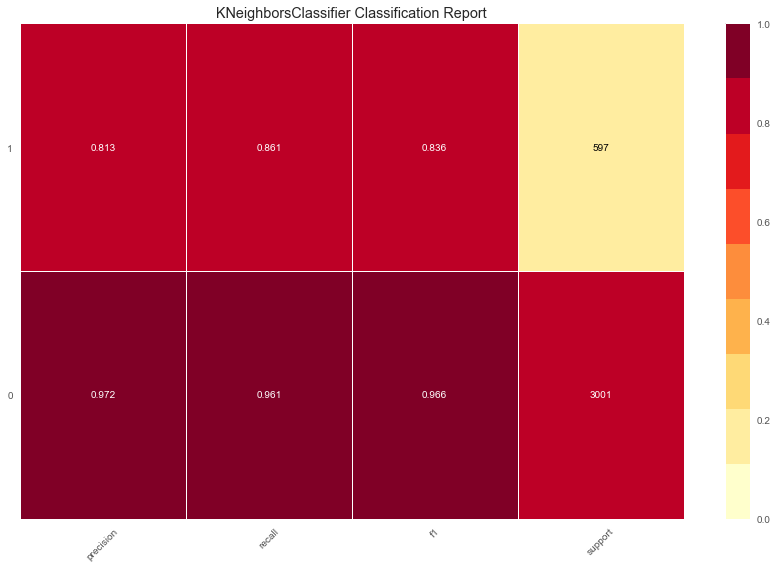

<AxesSubplot:title={'center':'KNeighborsClassifier Classification Report'}>

In [156]:
plt.figure(figsize=(12, 8))
visualizer = ClassificationReport(KNN_model, support=True)
visualizer.fit(X_train, y_train)        # Fit the visualizer and the model
visualizer.score(X_test, y_test)        # Evaluate the model on the test data
visualizer.show()

In [157]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.960,0.944
Precision,0.879,0.813
Recall,0.878,0.861
f1,0.879,0.836


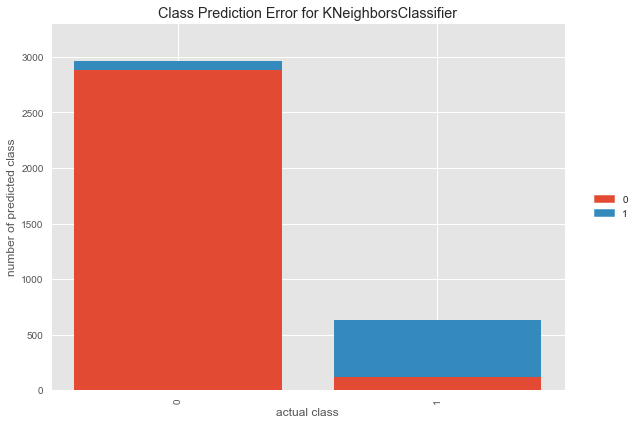

In [158]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(KNN_model)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

### 8.4.3 KNeighbors Classifier Cross Validation

In [159]:
KNN_cv = KNeighborsClassifier(n_neighbors = 5)

KNN_cv_scores = cross_validate(KNN_cv, X_train, y_train, 
                              scoring = ['accuracy', 'precision','recall', 'f1', 'roc_auc'], cv = 10)
KNN_cv_scores = pd.DataFrame(KNN_cv_scores, index = range(1, 11))

KNN_cv_scores.mean()[2:]

test_accuracy    0.948
test_precision   0.835
test_recall      0.859
test_f1          0.846
test_roc_auc     0.943
dtype: float64

### 8.4.4 Elbow Method for Choosing Reasonable K Values

[0.053362979433018376, 0.04307948860478039, 0.053085047248471406, 0.04558087826570312, 0.0558643690939411, 0.05141745414118959, 0.05697609783212898, 0.05669816564758201, 0.06142301278488049, 0.060867148415786554, 0.06475819899944413, 0.06698165647581988, 0.07031684269038352, 0.0714285714285714, 0.07559755419677594, 0.07448582545858806, 0.07809894385769867, 0.07865480822679272, 0.08032240133407453, 0.08282379099499726, 0.08393551973318514, 0.08643690939410786, 0.0861589772095609, 0.08893829905503059, 0.09032795997776544, 0.09088382434685938, 0.0933852140077821, 0.09310728182323513, 0.09366314619232907]


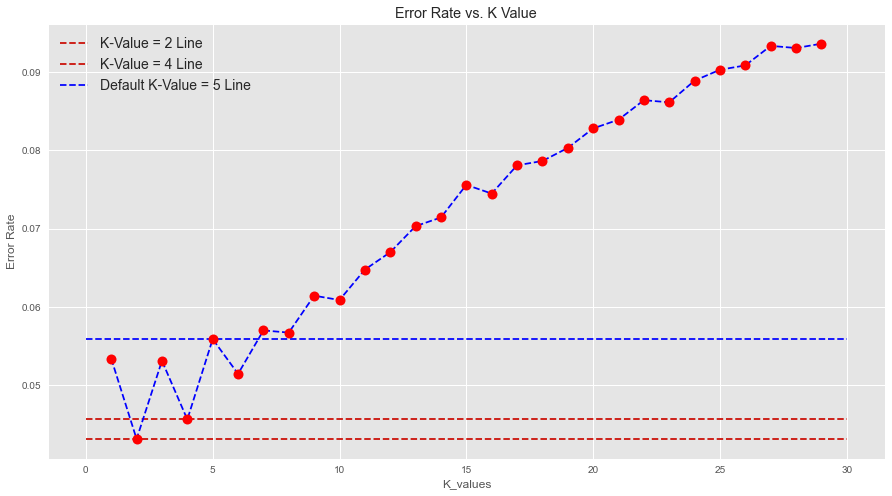

In [160]:
test_error_rates = []

for k in range(1, 30):
    KNN = KNeighborsClassifier(n_neighbors = k)
    KNN.fit(X_train, y_train) 
   
    y_pred = KNN.predict(X_test)
    
    test_error = 1 - accuracy_score(y_test, y_pred)
    test_error_rates.append(test_error)
    
print(test_error_rates)

plt.figure(figsize = (15, 8))
plt.plot(range(1, 30), test_error_rates, color = 'blue', linestyle = '--', marker = 'o',
         markerfacecolor = 'red', markersize = 10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K_values')
plt.ylabel('Error Rate')

plt.hlines(y = 0.04307948860478039, xmin = 0, xmax = 30, colors = 'r', linestyles = "--", label = "K-Value = 2 Line")
plt.hlines(y = 0.04558087826570312, xmin = 0, xmax = 30, colors = 'r', linestyles = "--", label = "K-Value = 4 Line")
plt.hlines(y = 0.055864369093941, xmin = 0, xmax = 30, colors = 'blue', linestyles = "--", label = "Default K-Value = 5 Line")
plt.legend(prop = {"size":14});

In [161]:
# FIRST A QUICK COMPARISON TO OUR DEFAULT K=5

knn5 = KNeighborsClassifier(n_neighbors = 5)

knn5.fit(X_train,y_train)
pred = knn5.predict(X_test)

print('WITH K=5')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=5
---------------
[[2883  118]
 [  83  514]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      3001
           1       0.81      0.86      0.84       597

    accuracy                           0.94      3598
   macro avg       0.89      0.91      0.90      3598
weighted avg       0.95      0.94      0.94      3598



In [162]:
# NOW K=2

knn2 = KNeighborsClassifier(n_neighbors = 2)

knn2.fit(X_train,y_train)
pred = knn2.predict(X_test)

print('WITH K=2')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=2
---------------
[[2951   50]
 [ 105  492]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.98      0.97      3001
           1       0.91      0.82      0.86       597

    accuracy                           0.96      3598
   macro avg       0.94      0.90      0.92      3598
weighted avg       0.96      0.96      0.96      3598



In [163]:
# NOW K=4

knn4 = KNeighborsClassifier(n_neighbors = 4)

knn4.fit(X_train,y_train)
pred = knn4.predict(X_test)

print('WITH K=4')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=4
---------------
[[2929   72]
 [  92  505]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.98      0.97      3001
           1       0.88      0.85      0.86       597

    accuracy                           0.95      3598
   macro avg       0.92      0.91      0.92      3598
weighted avg       0.95      0.95      0.95      3598



In [164]:
# NOW K=6

knn6 = KNeighborsClassifier(n_neighbors = 6)

knn6.fit(X_train,y_train)
pred = knn6.predict(X_test)

print('WITH K=6')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=6
---------------
[[2905   96]
 [  89  508]]
---------------
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      3001
           1       0.84      0.85      0.85       597

    accuracy                           0.95      3598
   macro avg       0.91      0.91      0.91      3598
weighted avg       0.95      0.95      0.95      3598



In [165]:
# NOW K=8

knn8 = KNeighborsClassifier(n_neighbors = 8)

knn8.fit(X_train,y_train)
pred = knn8.predict(X_test)

print('WITH K=8')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=8
---------------
[[2903   98]
 [ 106  491]]
---------------
              precision    recall  f1-score   support

           0       0.96      0.97      0.97      3001
           1       0.83      0.82      0.83       597

    accuracy                           0.94      3598
   macro avg       0.90      0.89      0.90      3598
weighted avg       0.94      0.94      0.94      3598



In [166]:
# NOW K=10

knn10 = KNeighborsClassifier(n_neighbors = 10)

knn10.fit(X_train,y_train)
pred = knn10.predict(X_test)

print('WITH K=10')
print('---------------')
print(confusion_matrix(y_test, pred))
print('---------------')
print(classification_report(y_test, pred))

WITH K=10
---------------
[[2898  103]
 [ 116  481]]
---------------
              precision    recall  f1-score   support

           0       0.96      0.97      0.96      3001
           1       0.82      0.81      0.81       597

    accuracy                           0.94      3598
   macro avg       0.89      0.89      0.89      3598
weighted avg       0.94      0.94      0.94      3598



### 8.4.5 KNeighbors Classifier GridsearchCV for Choosing Reasonable K Values

In [167]:
k_values = range(1, 30)
param_grid = {"n_neighbors": k_values, "p": [1, 2], "weights": ['uniform', "distance"]}
KNN_grid = KNeighborsClassifier()
KNN_grid_model = GridSearchCV(KNN_grid, param_grid, cv = 10, scoring = 'recall')  
KNN_grid_model.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': range(1, 30), 'p': [1, 2],
                         'weights': ['uniform', 'distance']},
             scoring='recall')

In [168]:
KNN_grid_model.best_estimator_

KNeighborsClassifier(n_neighbors=3, p=1, weights='distance')

In [169]:
print(colored('\033[1mBest Parameters of GridSearchCV for KNN Model:\033[0m', 'blue'), colored(KNN_grid_model.best_params_, 'cyan'))
print("--------------------------------------------------------------------------------------------------------------------")
print(colored('\033[1mBest Estimator of GridSearchCV for KNN Model:\033[0m', 'blue'), colored(KNN_grid_model.best_estimator_, 'cyan'))

Best Parameters of GridSearchCV for KNN Model: {'n_neighbors': 3, 'p': 1, 'weights': 'distance'}
--------------------------------------------------------------------------------------------------------------------
Best Estimator of GridSearchCV for KNN Model: KNeighborsClassifier(n_neighbors=3, p=1, weights='distance')


KNN_tuned (K=3)
------------------
[[2898  103]
 [  79  518]]
Test_Set
              precision    recall  f1-score   support

           0       0.97      0.97      0.97      3001
           1       0.83      0.87      0.85       597

    accuracy                           0.95      3598
   macro avg       0.90      0.92      0.91      3598
weighted avg       0.95      0.95      0.95      3598

Train_Set
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      6999
           1       0.91      0.91      0.91      1394

    accuracy                           0.97      8393
   macro avg       0.94      0.94      0.94      8393
weighted avg       0.97      0.97      0.97      8393



,train_set,test_set
Accuracy,0.969,0.949
Precision,0.909,0.834
Recall,0.906,0.868
f1,0.907,0.851


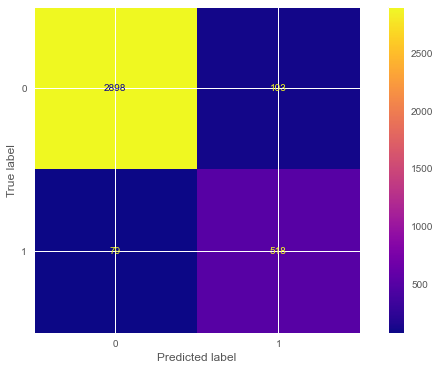

In [170]:
# NOW WITH K=3

KNN_tuned3 = KNeighborsClassifier(n_neighbors = 3, p = 1)
KNN_tuned3.fit(X_train, y_train)
y_pred = KNN_tuned3.predict(X_test)
y_train_pred = KNN_tuned3.predict(X_train)

KNN_tuned3_f1 = f1_score(y_test, y_pred)
KNN_tuned3_acc = accuracy_score(y_test, y_pred)
KNN_tuned3_recall = recall_score(y_test, y_pred)
KNN_tuned3_auc = roc_auc_score(y_test, y_pred)

print("KNN_tuned (K=3)")
print ("------------------")
eval(KNN_tuned3, X_train, X_test)
train_val(y_train, y_train_pred, y_test, y_pred)

KNN_tuned (K=1)
------------------
[[2882  119]
 [  84  513]]
Test_Set
              precision    recall  f1-score   support

           0       0.97      0.96      0.97      3001
           1       0.81      0.86      0.83       597

    accuracy                           0.94      3598
   macro avg       0.89      0.91      0.90      3598
weighted avg       0.95      0.94      0.94      3598

Train_Set
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6999
           1       1.00      1.00      1.00      1394

    accuracy                           1.00      8393
   macro avg       1.00      1.00      1.00      8393
weighted avg       1.00      1.00      1.00      8393



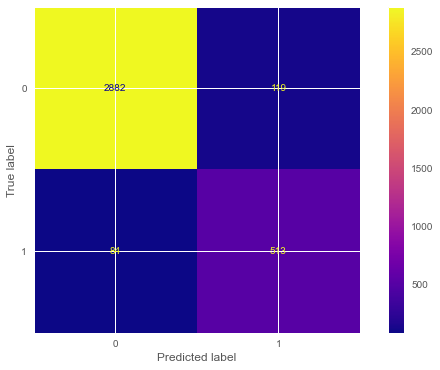

In [171]:
# NOW WITH K=1

KNN_tuned1 = KNeighborsClassifier(n_neighbors = 1, p = 1)
KNN_tuned1.fit(X_train, y_train)
y_pred = KNN_tuned1.predict(X_test)
y_train_pred = KNN_tuned1.predict(X_train)

KNN_tuned1_f1 = f1_score(y_test, y_pred)
KNN_tuned1_acc = accuracy_score(y_test, y_pred)
KNN_tuned1_recall = recall_score(y_test, y_pred)
KNN_tuned1_auc = roc_auc_score(y_test, y_pred)

print("KNN_tuned (K=1)")
print ("------------------")
eval(KNN_tuned1, X_train, X_test)

### 8.4.6 KNeighbors Classifier ROC (Receiver Operating Curve) and AUC (Area Under Curve)

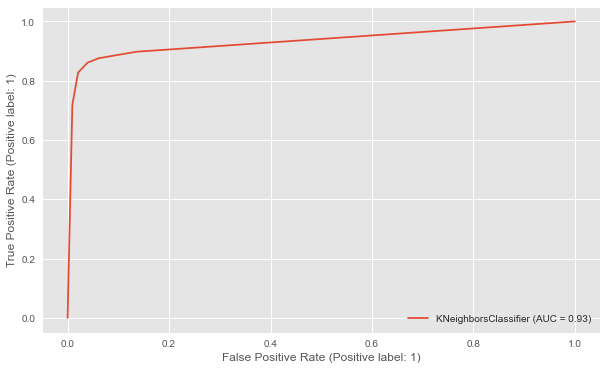

In [172]:
plot_roc_curve(KNN_model, X_test, y_test);

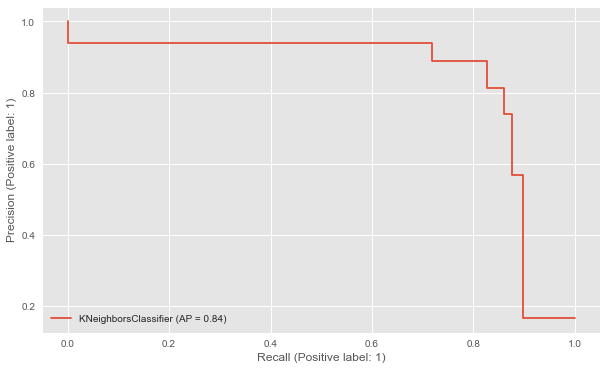

In [173]:
plot_precision_recall_curve(KNN_model, X_test, y_test);

### 8.4.7 Prediction

In [174]:
KNN_Pred = {"Actual": y_test, "KNN_Pred":y_pred}
KNN_Pred = pd.DataFrame.from_dict(KNN_Pred)
KNN_Pred.head(20)

,Actual,KNN_Pred
3109,0,0
10481,0,0
1104,1,1
3813,0,0
6864,0,0
9572,0,0
9703,0,0
8785,0,0
4821,0,0
179,1,1


In [175]:
KNN_Pred.drop("Actual", axis = 1, inplace = True)
Model_Preds = pd.merge(Model_Preds, KNN_Pred, left_index = True, right_index = True)
Model_Preds.head(20)

,Actual,GB_Pred,KNN_Pred
3109,0,0,0
10481,0,0,0
1104,1,1,1
3813,0,0,0
6864,0,0,0
9572,0,0,0
9703,0,0,0
8785,0,0,0
4821,0,0,0
179,1,1,1


### 8.5 - Random Forest Classifier

### 8.5.1 Model Building

In [176]:
RF_model = RandomForestClassifier(class_weight = "balanced", random_state = 101)
RF_model.fit(X_train, y_train)
y_pred = RF_model.predict(X_test)
y_train_pred = RF_model.predict(X_train)

RF_model_f1 = f1_score(y_test, y_pred)
RF_model_acc = accuracy_score(y_test, y_pred)
RF_model_recall = recall_score(y_test, y_pred)
RF_model_auc = roc_auc_score(y_test, y_pred)

### 8.5.2 Evaluating Model Performance

RF_Model
------------------
[[2996    5]
 [  58  539]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      3001
           1       0.99      0.90      0.94       597

    accuracy                           0.98      3598
   macro avg       0.99      0.95      0.97      3598
weighted avg       0.98      0.98      0.98      3598

Train_Set
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6999
           1       1.00      1.00      1.00      1394

    accuracy                           1.00      8393
   macro avg       1.00      1.00      1.00      8393
weighted avg       1.00      1.00      1.00      8393



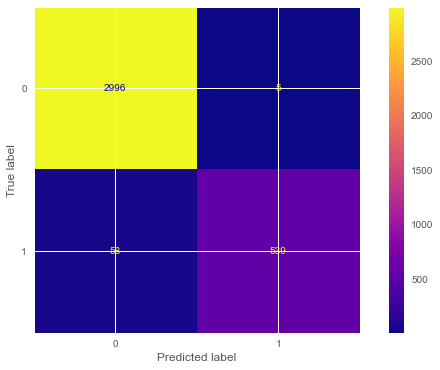

In [177]:
print("RF_Model")
print ("------------------")
eval(RF_model, X_train, X_test)

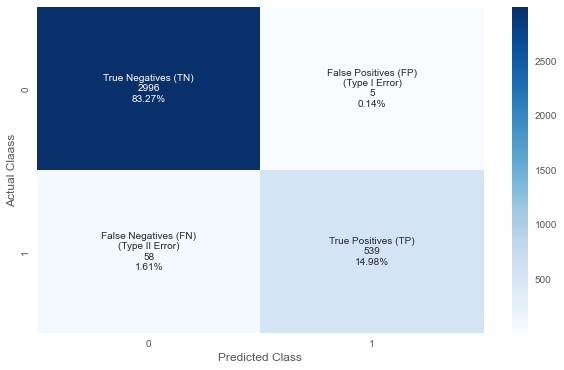

In [178]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

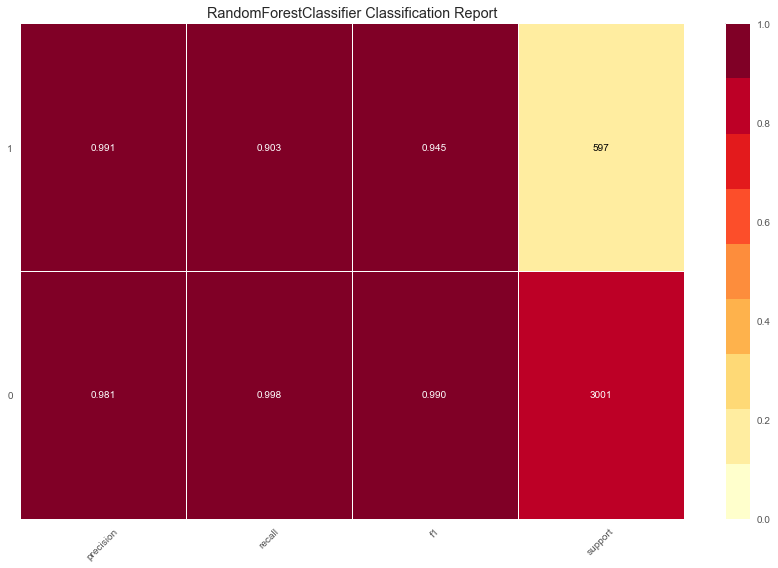

<AxesSubplot:title={'center':'RandomForestClassifier Classification Report'}>

In [179]:
plt.figure(figsize=(12, 8))
visualizer = ClassificationReport(RF_model, support=True)
visualizer.fit(X_train, y_train)        # Fit the visualizer and the model
visualizer.score(X_test, y_test)        # Evaluate the model on the test data
visualizer.show()

In [180]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,1.000,0.982
Precision,1.000,0.991
Recall,1.000,0.903
f1,1.000,0.945


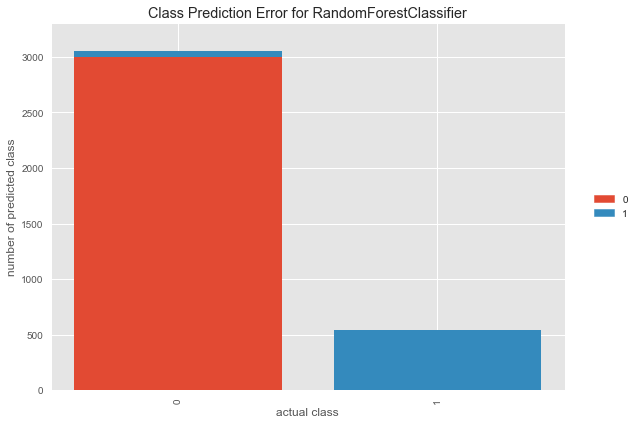

In [181]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(RF_model)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

### 8.5.3 Feature Importance for Random Forest Model

In [182]:
RF_feature_imp = pd.DataFrame(index=X.columns, data = RF_model.feature_importances_, columns = ['Importance']).sort_values("Importance", ascending = False)
RF_feature_imp

,Importance
satisfaction_level,0.282
time_spend_company,0.240
average_montly_hours,0.167
number_project,0.133
last_evaluation,0.132
work_accident,0.011
salary_low,0.007
salary_medium,0.004
department_sales,0.004
department_technical,0.004


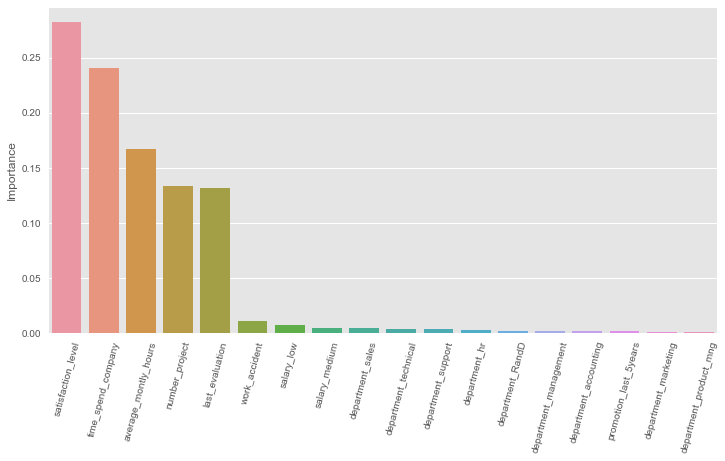

In [183]:
plt.figure(figsize = (12,6))
sns.barplot(data = RF_feature_imp.sort_values('Importance', ascending = False), x = RF_feature_imp.sort_values('Importance', ascending = False).index, y = 'Importance')
plt.xticks(rotation = 75);

### 8.5.4 Random Forest Classifier Cross Validation

In [184]:
RF_cv = RandomForestClassifier(class_weight = "balanced", random_state = 101)

RF_cv_scores = cross_validate(RF_cv, X_train, y_train, 
                              scoring = ['accuracy', 'precision','recall', 'f1', 'roc_auc'], cv = 10)
RF_cv_scores = pd.DataFrame(RF_cv_scores, index = range(1, 11))

RF_cv_scores.mean()[2:]

test_accuracy    0.982
test_precision   0.988
test_recall      0.905
test_f1          0.944
test_roc_auc     0.980
dtype: float64

### 8.5.5 Random Forest Classifier GridSearchCV

In [185]:
param_grid = {'n_estimators' : [50, 100, 300],
             'max_features' : [2, 3, 4],
             'max_depth' : [3, 5, 7, 9],
             'min_samples_split' : [2, 5, 8]}

In [186]:
RF_grid = RandomForestClassifier(class_weight = 'balanced', random_state = 101)
RF_grid_model = GridSearchCV(estimator = RF_grid, 
                             param_grid = param_grid, 
                             scoring = "recall", 
                             n_jobs = -1, verbose = 0)
RF_grid_model.fit(X_train, y_train)

GridSearchCV(estimator=RandomForestClassifier(class_weight='balanced',
                                              random_state=101),
             n_jobs=-1,
             param_grid={'max_depth': [3, 5, 7, 9], 'max_features': [2, 3, 4],
                         'min_samples_split': [2, 5, 8],
                         'n_estimators': [50, 100, 300]},
             scoring='recall')

In [187]:
RF_grid_model.best_estimator_

RandomForestClassifier(class_weight='balanced', max_depth=3, max_features=4,
                       n_estimators=300, random_state=101)

In [188]:
print(colored('\033[1mBest Parameters of GridSearchCV for Random Forest Model:\033[0m', 'blue'), colored(RF_grid_model.best_params_, 'cyan'))
print("--------------------------------------------------------------------------------------------------------------------")
print(colored('\033[1mBest Estimator of GridSearchCV for Random Forest Model:\033[0m', 'blue'), colored(RF_grid_model.best_estimator_, 'cyan'))

Best Parameters of GridSearchCV for Random Forest Model: {'max_depth': 3, 'max_features': 4, 'min_samples_split': 2, 'n_estimators': 300}
--------------------------------------------------------------------------------------------------------------------
Best Estimator of GridSearchCV for Random Forest Model: RandomForestClassifier(class_weight='balanced', max_depth=3, max_features=4,
                       n_estimators=300, random_state=101)


In [189]:
RF_tuned = RandomForestClassifier(class_weight = 'balanced',
                                  max_depth = 3,
                                  max_features = 4,
                                  n_estimators = 300,
                                  random_state = 101).fit(X_train, y_train)

In [190]:
y_pred = RF_tuned.predict(X_test)
y_train_pred = RF_tuned.predict(X_train)

RF_tuned_f1 = f1_score(y_test, y_pred)
RF_tuned_acc = accuracy_score(y_test, y_pred)
RF_tuned_recall = recall_score(y_test, y_pred)
RF_tuned_auc = roc_auc_score(y_test, y_pred)

RF_tuned
------------------
[[2804  197]
 [  47  550]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      0.93      0.96      3001
           1       0.74      0.92      0.82       597

    accuracy                           0.93      3598
   macro avg       0.86      0.93      0.89      3598
weighted avg       0.94      0.93      0.94      3598

Train_Set
              precision    recall  f1-score   support

           0       0.99      0.93      0.96      6999
           1       0.73      0.94      0.82      1394

    accuracy                           0.93      8393
   macro avg       0.86      0.93      0.89      8393
weighted avg       0.94      0.93      0.94      8393



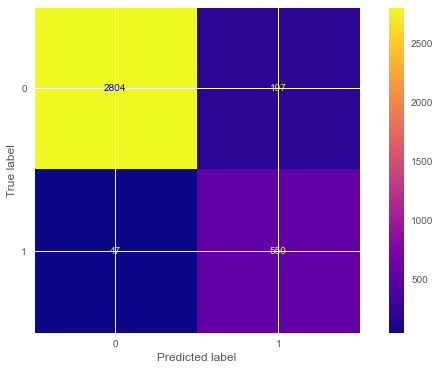

In [191]:
print("RF_tuned")
print ("------------------")
eval(RF_tuned, X_train, X_test)

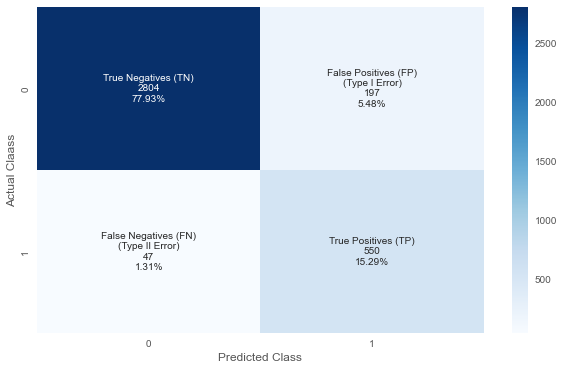

In [192]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

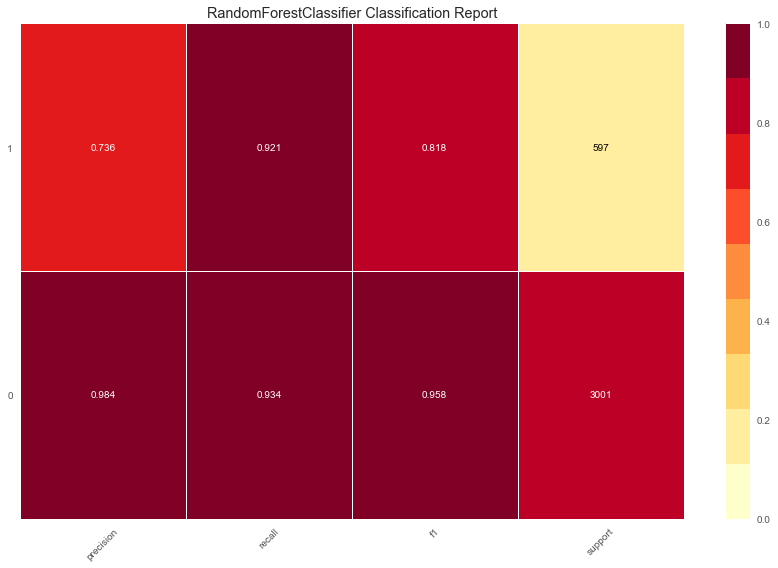

<AxesSubplot:title={'center':'RandomForestClassifier Classification Report'}>

In [193]:
plt.figure(figsize=(12, 8))
visualizer = ClassificationReport(RF_tuned, support=True)
visualizer.fit(X_train, y_train)        # Fit the visualizer and the model
visualizer.score(X_test, y_test)        # Evaluate the model on the test data
visualizer.show()

In [194]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.932,0.932
Precision,0.731,0.736
Recall,0.937,0.921
f1,0.821,0.818


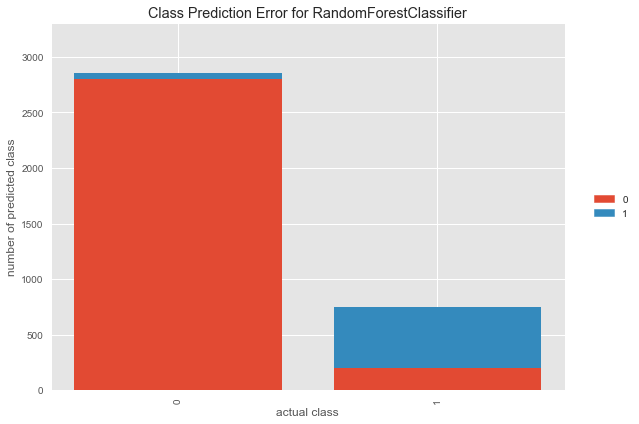

In [195]:
from yellowbrick.classifier import ClassPredictionError

visualizer = ClassPredictionError(RF_tuned)

# Fit the training data to the visualizer
visualizer.fit(X_train, y_train)

# Evaluate the model on the test data
visualizer.score(X_test, y_test)

# Draw visualization
visualizer.poof();

### 8.5.6 Random Forest Classifier ROC (Receiver Operating Curve) and AUC (Area Under Curve)

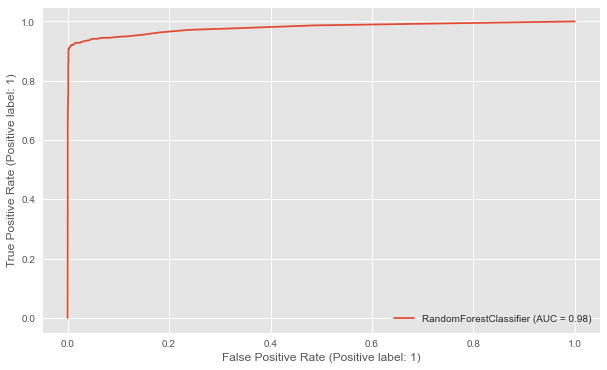

In [196]:
plot_roc_curve(RF_model, X_test, y_test);

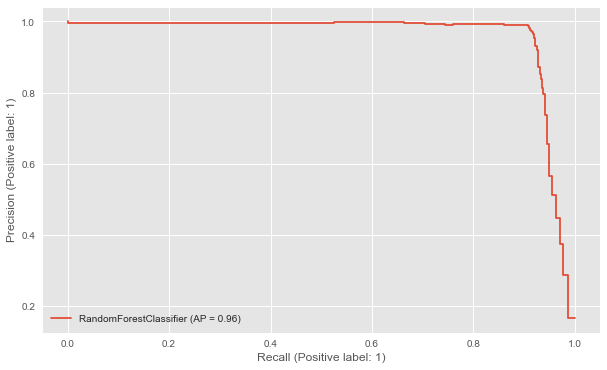

In [197]:
plot_precision_recall_curve(RF_model, X_test, y_test);

### 8.5.7 Prediction

In [198]:
RF_Pred = {"Actual": y_test, "RF_Pred":y_pred}
RF_Pred = pd.DataFrame.from_dict(RF_Pred)
RF_Pred.head(20)

,Actual,RF_Pred
3109,0,0
10481,0,0
1104,1,1
3813,0,0
6864,0,0
9572,0,0
9703,0,0
8785,0,0
4821,0,0
179,1,1


In [199]:
RF_Pred.drop("Actual", axis = 1, inplace = True)
Model_Preds = pd.merge(Model_Preds, RF_Pred, left_index = True, right_index = True)
Model_Preds.head(20)

,Actual,GB_Pred,KNN_Pred,RF_Pred
3109,0,0,0,0
10481,0,0,0,0
1104,1,1,1,1
3813,0,0,0,0
6864,0,0,0,0
9572,0,0,0,0
9703,0,0,0,0
8785,0,0,0,0
4821,0,0,0,0
179,1,1,1,1


In [200]:
Model_Preds.sample(10)

,Actual,GB_Pred,KNN_Pred,RF_Pred
4566,0,0,0,0
4043,0,0,0,1
9695,0,0,0,0
6476,0,0,0,0
10105,0,0,0,0
11097,0,0,0,0
2595,0,0,0,0
3796,0,0,0,0
3746,0,0,0,0
11149,0,0,0,0


## 8.6 - CatBoost Classifier
### 8.6.1 Model Building

In [201]:
from catboost import CatBoostClassifier

CB_model = CatBoostClassifier(verbose = False, scale_pos_weight = 4, random_state = 101)
CB_model.fit(X_train, y_train)
y_pred = CB_model.predict(X_test)
y_train_pred = CB_model.predict(X_train)

CB_model_f1 = f1_score(y_test, y_pred)
CB_model_acc = accuracy_score(y_test, y_pred)
CB_model_recall = recall_score(y_test, y_pred)
CB_model_auc = roc_auc_score(y_test, y_pred)

### 8.6.2 Evaluating Model Performance

CB_Model
------------------
[[2977   24]
 [  47  550]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      0.99      0.99      3001
           1       0.96      0.92      0.94       597

    accuracy                           0.98      3598
   macro avg       0.97      0.96      0.96      3598
weighted avg       0.98      0.98      0.98      3598

Train_Set
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      6999
           1       0.98      0.99      0.98      1394

    accuracy                           0.99      8393
   macro avg       0.99      0.99      0.99      8393
weighted avg       0.99      0.99      0.99      8393



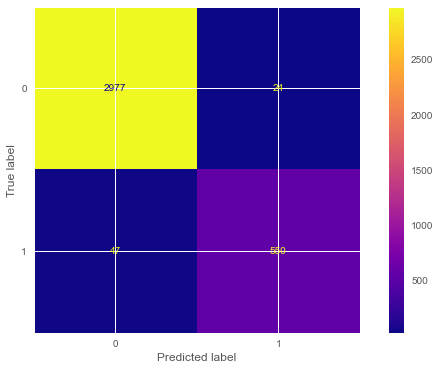

In [202]:
print("CB_Model")
print ("------------------")
eval(CB_model, X_train, X_test)

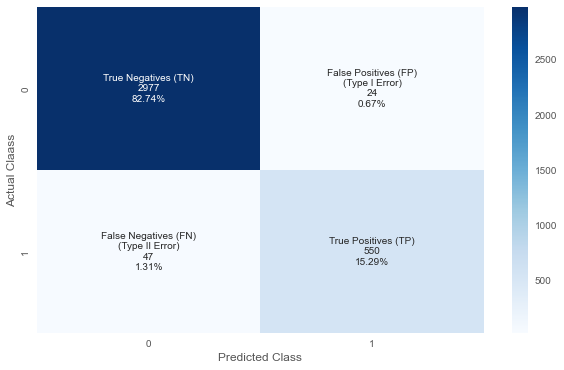

In [203]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

In [204]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.994,0.980
Precision,0.977,0.958
Recall,0.987,0.921
f1,0.982,0.939


### 8.6.3 Feature Importance for CatBoost Model

In [205]:
CB_feature_imp = pd.DataFrame(index = X.columns, data = CB_model.feature_importances_, columns = ['Importance']).sort_values("Importance", ascending = False)
CB_feature_imp

,Importance
satisfaction_level,26.423
time_spend_company,20.504
number_project,15.951
average_montly_hours,14.938
last_evaluation,13.180
salary_low,1.730
work_accident,1.684
salary_medium,1.175
department_support,0.892
department_sales,0.886


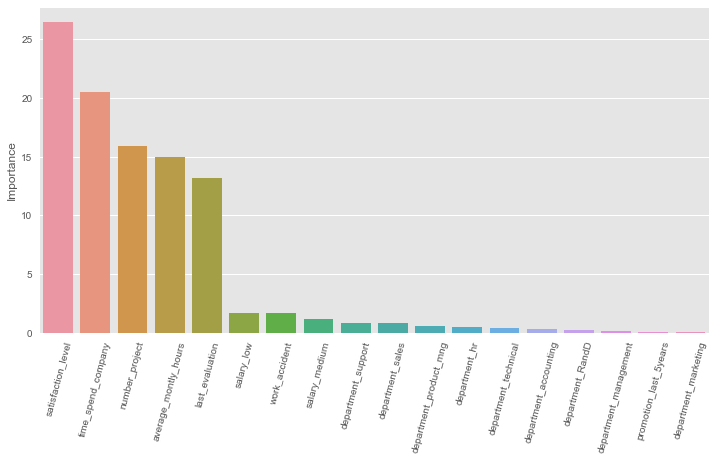

In [206]:
plt.figure(figsize = (12, 6))
sns.barplot(data = CB_feature_imp.sort_values('Importance', ascending = False), x = CB_feature_imp.sort_values('Importance', ascending = False).index, y = 'Importance')
plt.xticks(rotation = 75);

### 8.6.4 CatBoost Classifier Cross Validation

In [207]:
CB_cv = CatBoostClassifier(verbose = False, scale_pos_weight = 4, random_state = 101)

CB_cv_scores = cross_validate(CB_cv, X_train, y_train, 
                              scoring = ['accuracy', 'precision','recall', 'f1', 'roc_auc'], cv = 10)
CB_cv_scores = pd.DataFrame(CB_cv_scores, index = range(1, 11))

CB_cv_scores.mean()[2:]

test_accuracy    0.980
test_precision   0.952
test_recall      0.924
test_f1          0.938
test_roc_auc     0.983
dtype: float64

In [208]:
CB_cm = confusion_matrix(y_test, y_pred)
CB_cm

array([[2977,   24],
       [  47,  550]], dtype=int64)

In [209]:
CB_cm_df = pd.DataFrame(CB_cm)
CB_cm_df

,0,1
0,2977,24
1,47,550


In [210]:
CB_cm_df = CB_cm_df.rename(columns={0:"Employee_Stayed", 1:"Employe_Left"}, index={0:"Employee_Stayed", 1:"Employe_Left"})
CB_cm_df

,Employee_Stayed,Employe_Left
Employee_Stayed,2977,24
Employe_Left,47,550


In [211]:
CB_cm_df["Total"] = CB_cm_df["Employee_Stayed"] + CB_cm_df["Employe_Left"]
CB_cm_df

,Employee_Stayed,Employe_Left,Total
Employee_Stayed,2977,24,3001
Employe_Left,47,550,597


In [212]:
fig = px.bar(CB_cm_df, x="Employee_Stayed", y="Total", color="Employe_Left", title="CatBoost Confusion Matrix Distribution")

fig.update_layout(
    xaxis_title="Employees-Left                      Employees_Stayed",
    yaxis_title="The Number of Employees",
    font=dict(
        family="Courier New, monospace",
        size=14,
        color="#7f7f7f"
    )
)

fig.show()

### 8.6.5 CatBoost Classifier GridSearchCV

In [213]:
param_grid = {'learning_rate': [0.01, 0.03, 0.1, 0.5],
              'depth': [4, 6, 8, 10],
              'l2_leaf_reg': [1, 3, 5, 7, 9]}

In [214]:
CB_grid = CatBoostClassifier(verbose = False, scale_pos_weight = 4, random_state = 101)
CB_grid_model = GridSearchCV(estimator = CB_grid, 
                             param_grid = param_grid, 
                             scoring = "recall", 
                             n_jobs = -1, verbose = 0)
CB_grid_model.fit(X_train, y_train)

GridSearchCV(estimator=<catboost.core.CatBoostClassifier object at 0x000002465FA28940>,
             n_jobs=-1,
             param_grid={'depth': [4, 6, 8, 10], 'l2_leaf_reg': [1, 3, 5, 7, 9],
                         'learning_rate': [0.01, 0.03, 0.1, 0.5]},
             scoring='recall')

In [215]:
CB_grid_model.best_params_

{'depth': 4, 'l2_leaf_reg': 3, 'learning_rate': 0.01}

In [216]:
print(colored('\033[1mBest Parameters of GridSearchCV for Random Forest Model:\033[0m', 'blue'), 
      colored(CB_grid_model.best_params_, 'cyan'))

Best Parameters of GridSearchCV for Random Forest Model: {'depth': 4, 'l2_leaf_reg': 3, 'learning_rate': 0.01}


In [217]:
CB_tuned = CatBoostClassifier(verbose = False, 
                              scale_pos_weight = 4,
                              depth = 4,
                              l2_leaf_reg = 3,
                              learning_rate = 0.01,
                              random_state = 101).fit(X_train, y_train)  

In [218]:
y_pred = CB_tuned.predict(X_test)
y_train_pred = CB_tuned.predict(X_train)

CB_tuned_f1 = f1_score(y_test, y_pred)
CB_tuned_acc = accuracy_score(y_test, y_pred)
CB_tuned_recall = recall_score(y_test, y_pred)
CB_tuned_auc = roc_auc_score(y_test, y_pred)

CB_tuned
------------------
[[2946   55]
 [  45  552]]
Test_Set
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      3001
           1       0.91      0.92      0.92       597

    accuracy                           0.97      3598
   macro avg       0.95      0.95      0.95      3598
weighted avg       0.97      0.97      0.97      3598

Train_Set
              precision    recall  f1-score   support

           0       0.99      0.98      0.99      6999
           1       0.92      0.94      0.93      1394

    accuracy                           0.98      8393
   macro avg       0.96      0.96      0.96      8393
weighted avg       0.98      0.98      0.98      8393



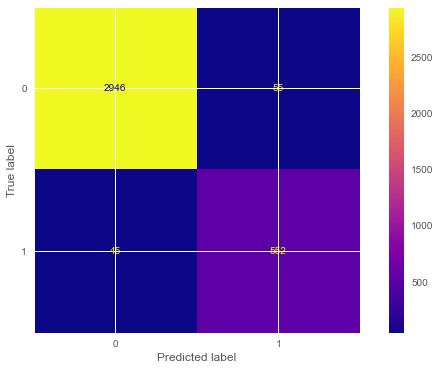

In [219]:
print("CB_tuned")
print ("------------------")
eval(CB_tuned, X_train, X_test)

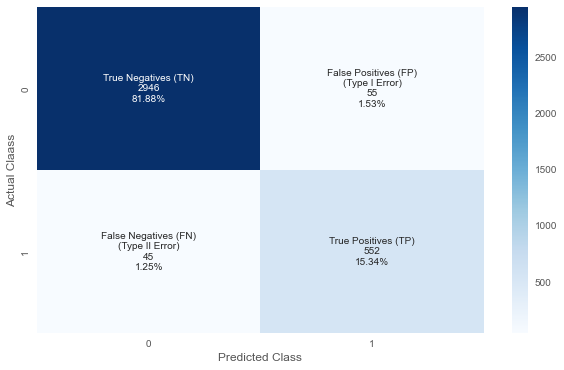

In [220]:
cf_matrix = confusion_matrix(y_test, y_pred)

group_names = ["True Negatives (TN)", "False Positives (FP)\n(Type I Error)", "False Negatives (FN)\n(Type II Error)", "True Positives (TP)"]

group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]

group_percentages = ["{0:.2%}".format(value) for value in
                     cf_matrix.flatten()/np.sum(cf_matrix)]

labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in
          zip(group_names, group_counts, group_percentages)]

labels = np.asarray(labels).reshape(2, 2)

ax = sns.heatmap(cf_matrix, annot=labels, fmt="", cmap="Blues")
ax.set(xlabel="Predicted Class", ylabel = "Actual Claass");

In [221]:
train_val(y_train, y_train_pred, y_test, y_pred)

,train_set,test_set
Accuracy,0.977,0.972
Precision,0.923,0.909
Recall,0.940,0.925
f1,0.931,0.917


In [222]:
CBtune_cm = confusion_matrix(y_test, y_pred)
CBtune_cm

array([[2946,   55],
       [  45,  552]], dtype=int64)

In [223]:
CBtune_cm_df = pd.DataFrame(CBtune_cm)
CBtune_cm_df

,0,1
0,2946,55
1,45,552


In [224]:
CBtune_cm_df = CBtune_cm_df.rename(columns={0:"Employee_Stayed", 1:"Employe_Left"}, index={0:"Employee_Stayed", 1:"Employe_Left"})
CBtune_cm_df

,Employee_Stayed,Employe_Left
Employee_Stayed,2946,55
Employe_Left,45,552


In [225]:
CBtune_cm_df["Total"] = CBtune_cm_df["Employee_Stayed"] + CBtune_cm_df["Employe_Left"]
CBtune_cm_df

,Employee_Stayed,Employe_Left,Total
Employee_Stayed,2946,55,3001
Employe_Left,45,552,597


In [226]:
fig = px.bar(CBtune_cm_df, x="Employee_Stayed", y="Total", color="Employe_Left", title="CatBoost-Tuned Confusion Matrix Distribution")

fig.update_layout(
    xaxis_title="Employees-Left                      Employees_Stayed",
    yaxis_title="The Number of Employees",
    font=dict(
        family="Courier New, monospace",
        size=14,
        color="#7f7f7f"
    )
)

fig.show()

### 8.6.6 CatBoost Classifier ROC (Receiver Operating Curve) and AUC (Area Under Curve)

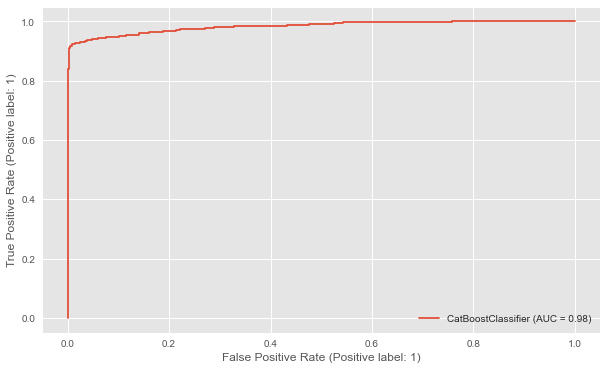

In [227]:
plot_roc_curve(CB_model, X_test, y_test);

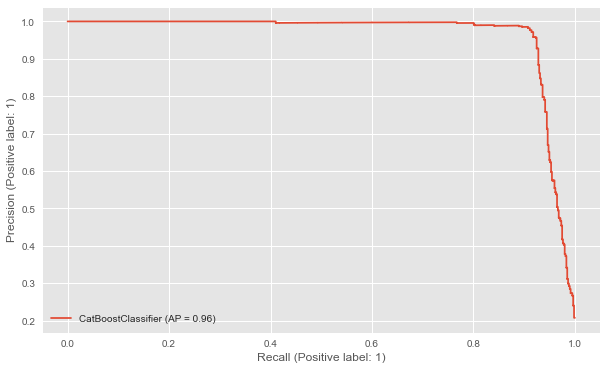

In [228]:
plot_precision_recall_curve(CB_model, X_test, y_test);

### 8.6.7 Prediction

In [229]:
CB_Pred = {"Actual": y_test, "CB_Pred":y_pred}
CB_Pred = pd.DataFrame.from_dict(CB_Pred)
CB_Pred.head()

,Actual,CB_Pred
3109,0,0
10481,0,0
1104,1,1
3813,0,0
6864,0,0


In [230]:
CB_Pred.drop("Actual", axis = 1, inplace = True)
Model_Preds = pd.merge(Model_Preds, CB_Pred, left_index = True, right_index = True)
Model_Preds.head()

,Actual,GB_Pred,KNN_Pred,RF_Pred,CB_Pred
3109,0,0,0,0,0
10481,0,0,0,0,0
1104,1,1,1,1,1
3813,0,0,0,0,0
6864,0,0,0,0,0


In [231]:
Model_Preds.sample(10)

,Actual,GB_Pred,KNN_Pred,RF_Pred,CB_Pred
4388,0,0,0,0,0
771,1,0,0,0,0
902,1,1,1,1,1
4920,0,0,0,0,0
4755,0,0,0,0,0
3658,0,0,0,0,0
1932,1,1,0,1,1
8223,0,0,0,0,0
10347,0,0,0,0,0
10632,0,0,0,0,0


In [232]:
#Model_Preds.loc[7347]

In [233]:
Model_Preds.shape

(3598, 5)

In [234]:
df2.loc[7347]

satisfaction_level         0.520
last_evaluation            0.560
number_project             3.000
average_montly_hours     225.000
time_spend_company         3.000
work_accident              0.000
promotion_last_5years      0.000
left                       0.000
department_RandD           0.000
department_accounting      1.000
department_hr              0.000
department_management      0.000
department_marketing       0.000
department_product_mng     0.000
department_sales           0.000
department_support         0.000
department_technical       0.000
salary_low                 0.000
salary_medium              1.000
Name: 7347, dtype: float64

## 9) THE COMPARISON OF MODELS

In [235]:
compare = pd.DataFrame({"Model": ["GB_model", "GB_tuned", "KNN_Model", "KNN_tuned3", "RF_model", "RF_tuned", "CB_model", 
                                  "CB_tuned"],
                        
                        "F1_Score": [GB_model_f1, GB_tuned_f1, KNN_model_f1, KNN_tuned3_f1, RF_model_f1, RF_tuned_f1, 
                                     CB_model_f1, CB_tuned_f1],
                                                 
                        "Accuracy_Score": [GB_model_acc, GB_tuned_acc, KNN_model_acc, KNN_tuned3_acc, RF_model_acc, 
                                           RF_tuned_acc, CB_model_acc, CB_tuned_acc],
                        
                        "Recall_Score": [GB_model_recall, GB_tuned_recall, KNN_model_recall, KNN_tuned3_recall, RF_model_recall, 
                                     RF_tuned_recall, CB_model_recall, CB_tuned_recall],
                       
                        "ROC_AUC_Score": [GB_model_auc, GB_tuned_auc, KNN_model_auc, KNN_tuned3_auc, RF_model_auc, 
                                          RF_tuned_auc, CB_model_auc, CB_tuned_auc]})

compare = compare.sort_values(by="Recall_Score", ascending=True)
fig = px.bar(compare, x = "Recall_Score", y = "Model", title = "Recall_Score")
fig.show()

compare = compare.sort_values(by="F1_Score", ascending=True)
fig = px.bar(compare, x = "F1_Score", y = "Model", title = "F1_Score")
fig.show()

compare = compare.sort_values(by="Accuracy_Score", ascending=True)
fig = px.bar(compare, x = "Accuracy_Score", y = "Model", title = "Accuracy_Score")
fig.show()

compare = compare.sort_values(by="ROC_AUC_Score", ascending=True)
fig = px.bar(compare, x = "ROC_AUC_Score", y = "Model", title = "ROC_AUC_Score")
fig.show()

## 10) MODEL DEPLOYMENT
Save and Export the Model as .pkl
Save and Export Variables as .pkl
You cooked the food in the kitchen and moved on to the serving stage. The question is how do you showcase your work to others? Model Deployement helps you showcase your work to the world and make better decisions with it. But, deploying a model can get a little tricky at times. Before deploying the model, many things such as data storage, preprocessing, model building and monitoring need to be studied. Streamlit is a popular open source framework used by data scientists for model distribution.

Deployment of machine learning models, means making your models available to your other business systems. By deploying models, other systems can send data to them and get their predictions, which are in turn populated back into the company systems. Through machine learning model deployment, can begin to take full advantage of the model you built.

Data science is concerned with how to build machine learning models, which algorithm is more predictive, how to design features, and what variables to use to make the models more accurate. However, how these models are actually used is often neglected. And yet this is the most important step in the machine learning pipline. Only when a model is fully integrated with the business systems, real values ​​can be extract from its predictions.

After doing the following operations in this notebook, jump to new .py file and create your web app with Streamlit.

### 10.1 - Save and Export the Model as .pkl

In [236]:
gradient_boosting_classifier = pickle.dump(GB_tuned, open('gradient_boosting_model', 'wb'))

<IPython.core.display.Javascript object>

In [237]:
kneighbors_classifier = pickle.dump(KNN_tuned3, open('kneighbors_model', 'wb'))

<IPython.core.display.Javascript object>

In [238]:
random_forest_classifier = pickle.dump(RF_tuned, open('random_forest_model', 'wb'))

<IPython.core.display.Javascript object>

In [239]:
catboost_classifier = pickle.dump(CB_tuned, open('catboost_model', 'wb'))

<IPython.core.display.Javascript object>

### 10.2 - Save and Export Variables as .pkl

In [240]:
df.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department,salary,left,predicted_clusters
0,0.380,0.530,2,157,3,0,0,sales,low,1,2
1,0.800,0.860,5,262,6,0,0,sales,medium,1,1
2,0.110,0.880,7,272,4,0,0,sales,medium,1,1
3,0.720,0.870,5,223,5,0,0,sales,low,1,2
4,0.370,0.520,2,159,3,0,0,sales,low,1,2


In [241]:
df1.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,department_RandD,department_accounting,department_hr,department_management,department_marketing,department_product_mng,department_sales,department_support,department_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,0,0,0,0,0,0,1,0,0,1,0


In [242]:
df2.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,work_accident,promotion_last_5years,left,department_RandD,department_accounting,department_hr,department_management,department_marketing,department_product_mng,department_sales,department_support,department_technical,salary_low,salary_medium
0,0.380,0.530,2,157,3,0,0,1,0,0,0,0,0,0,1,0,0,1,0
1,0.800,0.860,5,262,6,0,0,1,0,0,0,0,0,0,1,0,0,0,1
2,0.110,0.880,7,272,4,0,0,1,0,0,0,0,0,0,1,0,0,0,1
3,0.720,0.870,5,223,5,0,0,1,0,0,0,0,0,0,1,0,0,1,0
4,0.370,0.520,2,159,3,0,0,1,0,0,0,0,0,0,1,0,0,1,0


In [243]:
df.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years', 'department', 'salary', 'left',
       'predicted_clusters'],
      dtype='object')

In [244]:
df1.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years', 'department_RandD', 'department_accounting',
       'department_hr', 'department_management', 'department_marketing',
       'department_product_mng', 'department_sales', 'department_support',
       'department_technical', 'salary_low', 'salary_medium'],
      dtype='object')

In [245]:
df2.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'work_accident',
       'promotion_last_5years', 'left', 'department_RandD',
       'department_accounting', 'department_hr', 'department_management',
       'department_marketing', 'department_product_mng', 'department_sales',
       'department_support', 'department_technical', 'salary_low',
       'salary_medium'],
      dtype='object')

In [246]:
col_lst = ['satisfaction_level', 'last_evaluation', 'number_project', 'average_montly_hours', 'time_spend_company', 
           'work_accident', 'promotion_last_5years', 'department_RandD', 'department_accounting', 'department_hr', 
           'department_management', 'department_marketing', 'department_product_mng', 'department_sales', 
           'department_support', 'department_technical', 'salary_low', 'salary_medium']

scaler = MinMaxScaler()
scaler_fitted = scaler.fit(df2[col_lst])
scaler_deploy = pickle.dump(scaler_fitted, open('scaler.sav', 'wb'))

<IPython.core.display.Javascript object>

What will be done to deploy our Model
1) Save you model using pickle (We did it in section 10.1).

2) Create a folder.

3) Inside the folder, create a .py extesion file which includes related codes for deployment and templates icluding index.htmml file if you will use flask for deployment(in our case we will use streamlit so we do NOT need it).

4) Put all related files including requirements.txt, all model files saved and images you will use in your .py file for deployment.

5) Sign in your account at https://aws.amazon.com/ and run your instance under ec2.

6) Open your Visual Studio Code IDE.

7) Make sure your Public IPv4 address at Open SSH configuratin file is the same as the one in your instance if you restart it again (If you change it do NOT forget to save).

8) Make a remote connection by connecting to Host via selecting related instance (Before doing this, if you wish, you can also publish the model at your local IP.).

9) After connecting the remote, put your folder by either "Open Folder" window or just drag and drop the folder. 10) Find and change your directory where your folder is by pwd, ls and cd commands.

11) Just run your .py file via streamlit run ".......".py (in our case streamlit run appN.py) (If there are NOT some libraries in your environment needed for deoployment or you need additional libraries for deployment please install them. Moreover, you have to need exact versions of libraries which you built your models with and needed for deployment).

12) Now you can see your deployment at External URL by clicking it.

13) However, you need a last step to be activated if you want it to be streamed even if you close your Visual Studio Code IDE.

14) Open and create a new tmux session via tmux and tmux new -s session_name, respectively (If you do NOT have Tmux package install it viaa sudo apt install tmux).